In [1]:
from neo import io
import neo
import numpy as np
from pathlib import Path
import matplotlib.pylab as plt 
import seaborn as sns
import plotly.express as px
import pandas as pd
from pathlib import Path
from scipy.signal import convolve
from scipy.signal.windows import triang
from sklearn.decomposition import PCA, FastICA
from scipy import stats
from utils import *
from utils_spectral import *
from utils_BK_corr import *
from utils_analysis import *
import matplotlib.colors as mcolors
from matplotlib.gridspec import GridSpec
from utils import *
from utils_analysis import *
from utils_spectral import *
from utils_BK_corr import *
from color_manager import *
import matplotlib.font_manager
from matplotlib import font_manager

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils_spectral.py:4: DeprecationWarning: 
The `fooof` package is being deprecated and replaced by the `specparam` (spectral parameterization) package.
This version of `fooof` (1.1) is fully functional, but will not be further updated.
New projects are recommended to update to using `specparam` (see Changelog for details).
  from fooof import FOOOF


In [2]:
# useful for plotting
sns.set_theme(style="dark")
sns.set_context("notebook")
plt.style.use('ggplot')
plt.rcParams['figure.dpi'] = 200
plt.rcParams['savefig.dpi'] = 200
plt.rcParams['axes.titlesize'] = 10
plt.rcParams['axes.labelsize'] = 10
plt.rcParams['xtick.labelsize'] = 6
plt.rcParams['ytick.labelsize'] = 6
plt.rcParams['legend.fontsize'] = 6
plt.rcParams['font.family'] = 'DejaVu Serif'

In [3]:
# loading color schemes
aperiodic_scheme = color_manager.load_color_scheme('aperiodic_exponent')
mean_fr_scheme = color_manager.load_color_scheme('mean_firing_rate')
phase_scheme = color_manager.load_color_scheme('mean_phase')
energy_scheme = color_manager.load_color_scheme('total_energy')
entire_mean_fr_scheme = color_manager.load_color_scheme('mean_firing_rate_entire')
synapse_scheme = color_manager.load_color_scheme('total_weighted_synapses')

Color scheme 'aperiodic_exponent' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_aperiodic_exponent.pkl
Color scheme 'mean_firing_rate' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_mean_firing_rate.pkl
Color scheme 'mean_phase' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_mean_phase.pkl
Color scheme 'total_energy' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_total_energy.pkl
Color scheme 'mean_firing_rate_entire' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_mean_firing_rate_entire.pkl
Color scheme 'total_weighted_synapses' loaded from /home/nix/Uni/3Year/Thesis/testStefania/multiLevels/color_scheme_total_weighted_synapses.pkl


In [4]:
aperiodic_scheme.keys()

dict_keys(['colors_raw', 'labels_data', 'labels_display', 'label_colors'])

In [5]:
# loading data
PATH = "/home/nix/Uni/3Year/Thesis/testStefania/multiLevels"

# the entire recording with the stimulus
corr_results_stimulus = pd.read_csv(Path(PATH) / "correlation_results_stimulus.csv")
foof_features_stimulus = pd.read_csv(Path(PATH) / "foof_features_stimulus_full.csv")


# baseline
corr_results_baseline = pd.read_csv(Path
(PATH) / "correlation_results_baseline12.csv")
foof_features_baseline = pd.read_csv(Path(PATH) / "foof_features_baseline_full.csv")
psdPC_baseline = pd.read_csv(Path(PATH) / "psdPC_baseline12.csv")

# step stimulus
corr_results_step = pd.read_csv(Path(PATH) / "correlation_results_step.csv")
foof_features_step = pd.read_csv(Path(PATH) / "foof_features_step_full.csv")
psdPC_step = pd.read_csv(Path(PATH) / "psdPC_step.csv")

# burst stimulus
corr_results_burst = pd.read_csv(Path(PATH) / "correlation_results_burst.csv")
foof_features_burst = pd.read_csv(Path(PATH) / "foof_features_burst_full.csv")
psdPC_burst = pd.read_csv(Path(PATH) / "psdPC_burst.csv")

In [6]:
np.max(foof_features_burst['Mean_Firing_Rate'])

np.float64(125.78125)

In [7]:
df_spikes = pd.read_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/pc_spikes.csv')

Shape: (86590, 2)
[[4.90000e+00 3.31240e+04]
 [6.20000e+00 3.31540e+04]
 [1.86000e+01 3.31240e+04]
 ...
 [2.49696e+04 3.31100e+04]
 [2.49866e+04 3.31400e+04]
 [2.49885e+04 3.31100e+04]]
Computing firing rates of purkinje
Number of neurons: 68
Time vector: 0 25000.4
Number of bins: 5001
Kernel size: 8
Neuron ID: 33097.0
First few spikes: [ 8.5 27.9 52.  76.  97.7]
Neuron ID: 33098.0
First few spikes: [ 9.1 27.7 50.9 71.2 91. ]
Neuron ID: 33099.0
First few spikes: [ 6.1 22.7 42.3 66.1 86. ]
Rates array shape: (68, 5001)
Rates array first few values: [[31.25 43.75 50.   ... 18.75  6.25  0.  ]
 [31.25 43.75 50.   ... 50.   50.   43.75]
 [31.25 50.   62.5  ... 31.25 18.75  6.25]
 [18.75 31.25 50.   ... 31.25 18.75  6.25]
 [31.25 43.75 50.   ... 31.25 18.75  6.25]]
Rates array first few neurons: [[31.25 43.75 50.   50.   50.  ]
 [31.25 43.75 50.   50.   50.  ]
 [31.25 50.   62.5  62.5  62.5 ]
 [18.75 31.25 50.   62.5  62.5 ]
 [31.25 43.75 50.   50.   50.  ]
 [31.25 43.75 50.   50.   50.  ]
 

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


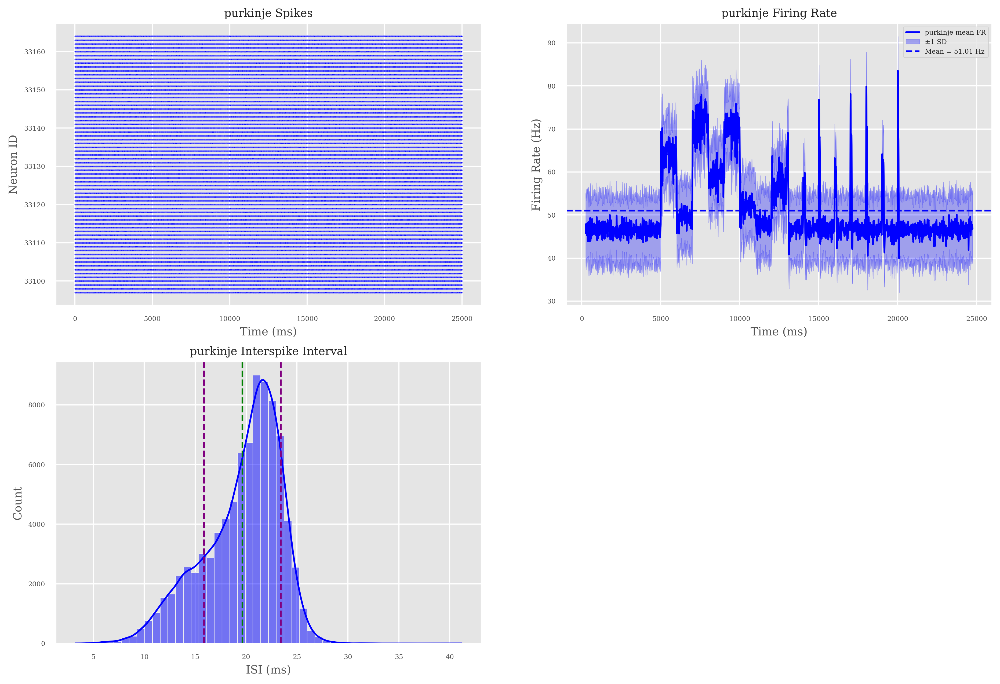

In [8]:
times_vectorPC, mean_ratePC, rates_per_neuronPC, stats_popPC, isi_dictPC, stats_dictPC, df_spikes = process_pop(df_spikes, "purkinje", color="blue", mask_flag=True, dt=5, sigma=20)

/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils_analysis.py:41: FutureWarning: The behavior of obj[i:j] with a float-dtype index is deprecated. In a future version, this will be treated as positional instead of label-based. For label-based slicing, use obj.loc[i:j] instead
  sns.heatmap(heatmap_data.T[:100], ax=ax, cmap='plasma', cbar_kws={'label': 'Counts Frequencies'})


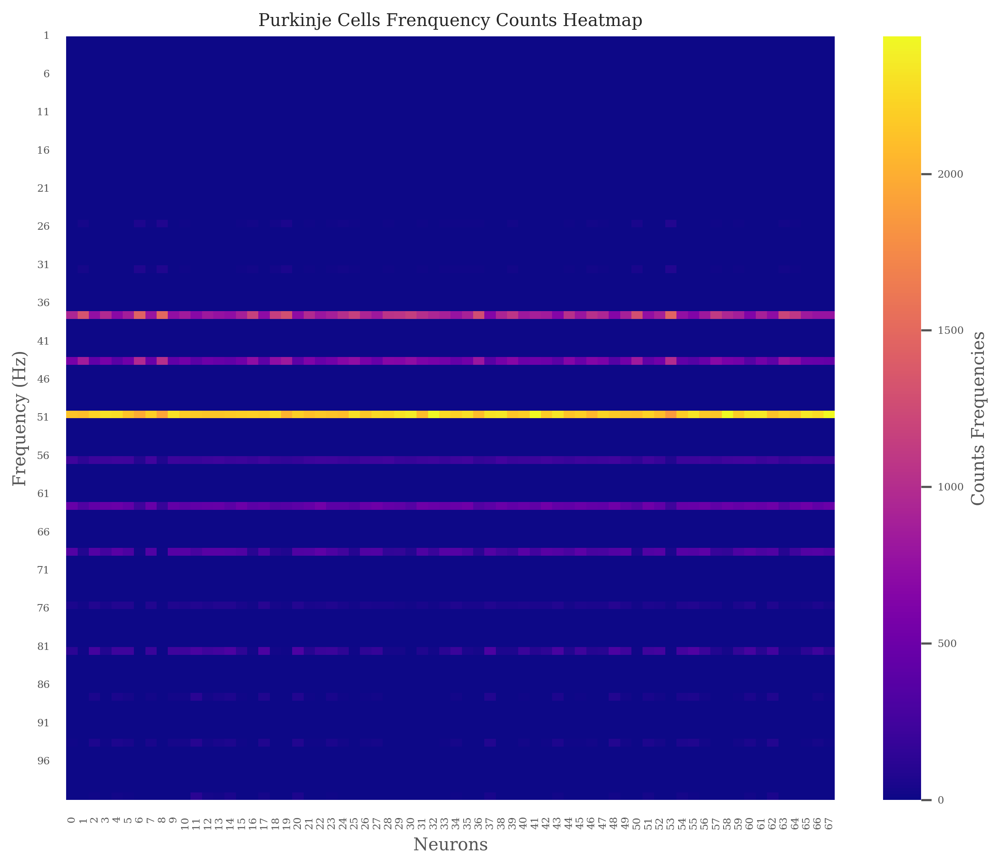

In [9]:
stimulus_heatmap = heatmap_firing_rates(rates_per_neuronPC)
plot_count_heatmap(stimulus_heatmap, "Purkinje Cells Frenquency Counts Heatmap")

In [10]:
print(f"Number of zero entries in heatmap: {(stimulus_heatmap == 0).sum().sum()}")
print(f"Number of total entries in stimulus_heatmap: {stimulus_heatmap.size}\n")

Number of zero entries in heatmap: 12613
Number of total entries in stimulus_heatmap: 13532



PCA explained variance ratio: [0.83297048 0.11332068]
PCA Summary:
PC1 explains 83.3% of variance
PC2 explains 11.3% of variance


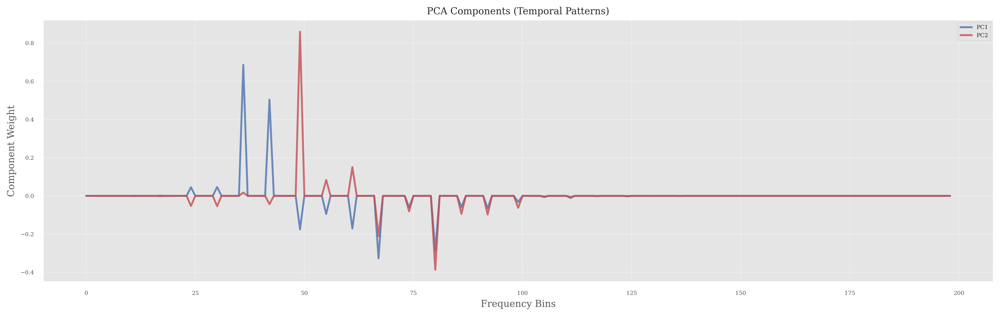

In [11]:
heatmap_pca, pca_obj = PCA_heatmap(stimulus_heatmap, n_components=2)
_ = plot_pca_analysis(stimulus_heatmap, pca_obj)

K-Means Clustering: 2 clusters
Silhouette Coefficient: 0.548


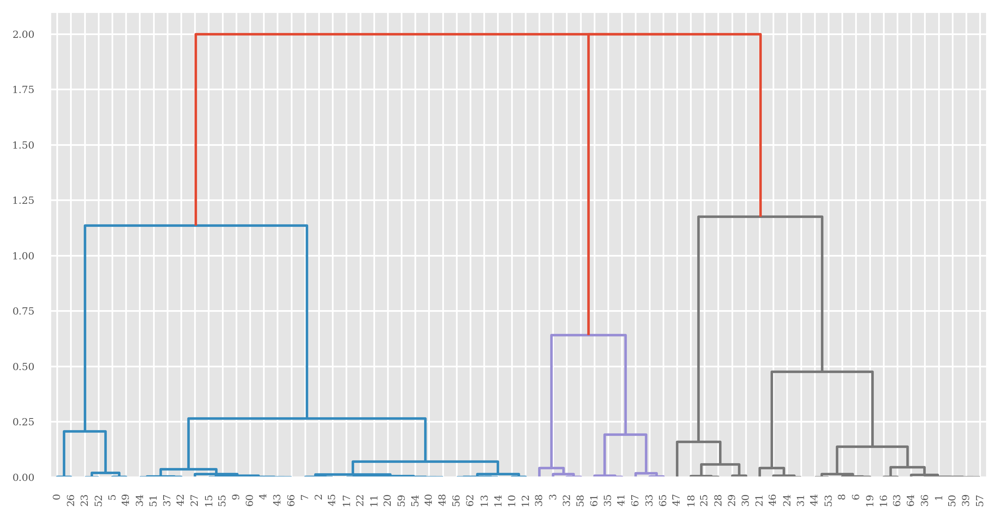

Hierarchical Clustering: 2 clusters
Silhouette Coefficient: 0.435
First 5 neurons (sorted by Cell ID):
   Cell_ID  Frequency Label  Original_Index
0        1  50.928382    ON               0
1        2  46.806774   OFF               1
2        3  53.654866    ON               2
3        4  50.122424    ON               3
4        5  53.825750    ON               4


/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)
/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/seaborn/categorical.py:700: PendingDeprecationWarning: vert: bool will be deprecated in a future version. Use orientation: {'vertical', 'horizontal'} instead.
  artists = ax.bxp(**boxplot_kws)


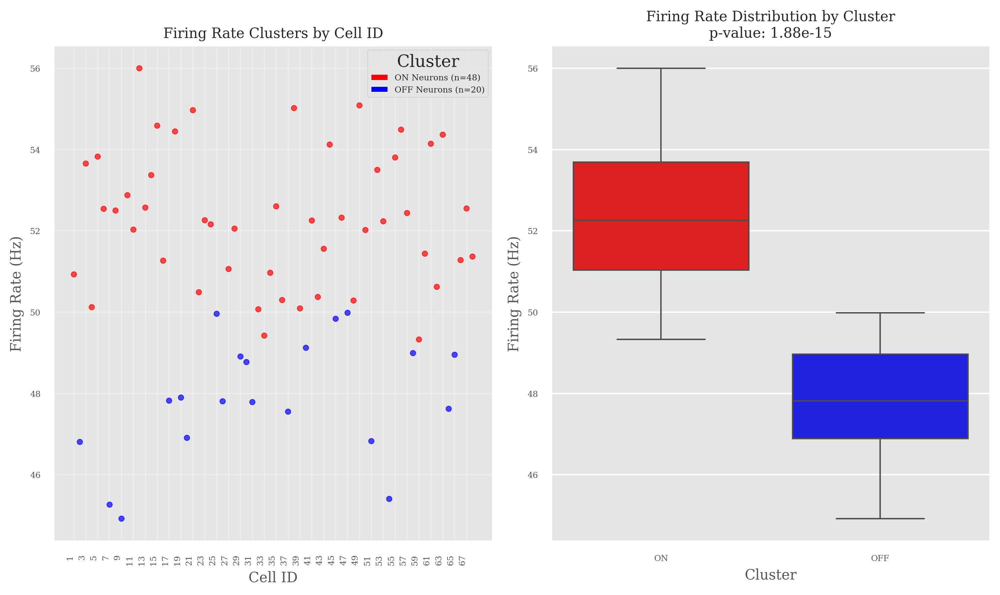

In [12]:
labels_stimulus = kmeans_cluster(heatmap_pca, n_clusters=2)
hierarchical_labels = hierarchical_cluster(heatmap_pca, n_clusters=2)
neuronsON, neuronsOFF = plot_fr_clusters(rates_per_neuronPC, labels_stimulus)

In [13]:
def plot_neuron_firing_rate(rates_per_neuron, column_name='Mean_Firing_Rate', 
                          title='Neuron Firing Rates', figsize=(8.27, 10), rows=9, cols=8,
                          colors_raw=None, labels_data=None, labels_display=None, 
                          label_colors=None, cell_features_df=None):
    """
    Plot individual neuron firing rates colored by a specified feature with colorbar.
    
    Parameters:
    - rates_per_neuron: Array/DataFrame with firing rates per neuron (neurons x time)
    - column_name: Column name in cell_features_df to use for coloring (e.g., 'Mean_Firing_Rate')
    - title: Main title for the plot
    - figsize: Figure size tuple
    - rows, cols: Grid layout for subplots
    - colors_raw: Dictionary mapping feature values to colors
    - labels_data: Data for heatmap labels
    - labels_display: Display labels for heatmap
    - label_colors: List of colors for heatmap
    - cell_features_df: DataFrame containing 'cell_id' and feature columns (e.g., foof_features_stimulus)
    """
    custom_cmap_mean_fr = mcolors.ListedColormap(label_colors) if label_colors else plt.cm.viridis
    
    fig = plt.figure(figsize=figsize, dpi=300)
    gs_main = GridSpec(1, 2, figure=fig, 
                       width_ratios=[12, 0.3],  # Adjusted ratios to fit better
                       left=0.08, right=0.95, top=0.88, bottom=0.08, 
                       wspace=0.04)

    ax_main = fig.add_subplot(gs_main[0, 0])
    ax_main.set_visible(False)

    gs_neurons = GridSpec(rows, cols, figure=fig, 
                         left=0.08, right=0.83, top=0.88, bottom=0.08,  # Adjusted margins
                         hspace=0.6, wspace=0.4)  # Reduced spacing to fit better

    ax_heatmap = fig.add_subplot(gs_main[0, 1])

    # Calculate global y-axis limits for all neurons
    y_min = np.min(rates_per_neuron)
    y_max = np.max(rates_per_neuron)
    # Add a small margin (5% of the range)
    y_range = y_max - y_min
    y_margin = y_range * 0.05
    global_ylim = (y_min - y_margin, y_max + y_margin)

    # Colors for each neuron based on feature values
    neuron_colors = []
    for i in range(len(rates_per_neuron)):
        if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                # Find the closest color in our color scheme
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    # Find closest value if exact match not found
                    color_keys = np.array(list(colors_raw.keys()))
                    if np.isfinite(feature_value):
                        value_idx = np.argmin(np.abs(color_keys - feature_value))
                        closest_value = color_keys[value_idx]
                        neuron_colors.append(colors_raw[closest_value])
                    else:
                        neuron_colors.append('gray')
            else:
                neuron_colors.append('gray')  # Fallback color
        else:
            neuron_colors.append('blue')  # Default color

    # Store all axes
    all_neuron_axes = []
    
    n_neurons = len(rates_per_neuron)
    for i in range(n_neurons):
        row = i // cols
        col = i % cols
        ax = fig.add_subplot(gs_neurons[row, col])
        all_neuron_axes.append(ax)
        
        ax.plot(rates_per_neuron[i], color=neuron_colors[i], alpha=0.7, linewidth=0.8)
        
        # Use cell_id if provided, otherwise use default numbering
        if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
            if i < len(cell_features_df):
                neuron_name = f'N{int(cell_features_df.iloc[i]["cell_id"])}'  # Shortened label
            else:
                neuron_name = f'N{i+1}'
        else:
            neuron_name = f'N{i+1}'
            
        ax.set_title(neuron_name, fontsize=7)  # Smaller font
        
        # Only show y-axis labels and ticks on the first column
        if col == 0:
            ax.set_ylabel('Rate (Hz)', fontsize=6)
            # Keep y-axis ticks visible
            ax.tick_params(axis='y', which='major', labelsize=4, left=True, labelleft=True)
        else:
            ax.set_ylabel('')
            # Hide y-axis ticks and labels for all other columns
            ax.tick_params(axis='y', which='major', left=False, labelleft=False)
            
        # Only show x-axis labels on bottom row
        if row == rows - 1 or i >= n_neurons - cols:  # Bottom row
            ax.set_xlabel('Time', fontsize=6)
            ax.tick_params(axis='x', which='major', labelsize=4)
        else:
            ax.set_xlabel('')
            ax.tick_params(axis='x', which='major', labelsize=4, bottom=True, labelbottom=False)
            
        ax.grid(True, alpha=0.2)
        
        # Set the same y-axis limits for all subplots
        ax.set_ylim(global_ylim)

    # Print y-axis range for reference
    print(f"Global y-axis range: {global_ylim[0]:.2f} to {global_ylim[1]:.2f} Hz")

    # Colorbar heatmap
    if labels_data is not None and labels_display is not None:
        sns.heatmap(data=labels_data, ax=ax_heatmap, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        ax_heatmap.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=8)
        ax_heatmap.tick_params(axis='y', labelsize=6)

    fig.suptitle(title, fontsize=10, y=0.95)
    plt.tight_layout()
    plt.show()

In [14]:
def plot_neuron_firing_rate(rates_per_neuron, column_name='Mean_Firing_Rate', 
                          title='Neuron Firing Rates', figsize=(12, 9), rows=9, cols=8,
                          colors_raw=None, labels_data=None, labels_display=None, 
                          label_colors=None, cell_features_df=None):
    """
    Plot individual neuron firing rates colored by a specified feature with colorbar.
    """
    custom_cmap_mean_fr = mcolors.ListedColormap(label_colors) if label_colors else plt.cm.viridis
    
    fig = plt.figure(figsize=figsize, dpi=300)
    gs_main = GridSpec(1, 2, figure=fig, 
                       width_ratios=[12, 0.3],
                       left=0.08, right=0.95, top=0.88, bottom=0.08, 
                       wspace=0.5)

    ax_main = fig.add_subplot(gs_main[0, 0])
    ax_main.set_visible(False)

    gs_neurons = GridSpec(rows, cols, figure=fig, 
                         left=0.01, right=0.89, top=0.89, bottom=0.08,
                         hspace=2, wspace=0.3)

    ax_heatmap = fig.add_subplot(gs_main[0, 1])

    # Calculate global y-axis limits for all neurons
    y_min = np.min(rates_per_neuron)
    y_max = np.max(rates_per_neuron)
    y_range = y_max - y_min
    y_margin = y_range * 0.05
    global_ylim = (y_min - y_margin, y_max + y_margin)

    # Colors for each neuron based on feature values
    neuron_colors = []
    for i in range(len(rates_per_neuron)):
        if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    color_keys = np.array(list(colors_raw.keys()))
                    if np.isfinite(feature_value):
                        value_idx = np.argmin(np.abs(color_keys - feature_value))
                        closest_value = color_keys[value_idx]
                        neuron_colors.append(colors_raw[closest_value])
                    else:
                        neuron_colors.append('gray')
            else:
                neuron_colors.append('gray')
        else:
            neuron_colors.append('blue')

    all_neuron_axes = []
    n_neurons = len(rates_per_neuron)
    
    for i in range(n_neurons):
        row = i // cols
        col = i % cols
        ax = fig.add_subplot(gs_neurons[row, col])
        all_neuron_axes.append(ax)
        
        ax.plot(rates_per_neuron[i], color=neuron_colors[i], alpha=0.7, linewidth=0.2)
        
        # Use cell_id if provided, otherwise use default numbering
        if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
            if i < len(cell_features_df):
                neuron_name = f'N{int(cell_features_df.iloc[i]["cell_id"])}'
            else:
                neuron_name = f'N{i+1}'
        else:
            neuron_name = f'N{i+1}'
            
        ax.set_title(neuron_name, fontsize=7)
        
        # Y-axis: Only show on first column
        if col == 0:
            ax.set_ylabel('Rate (Hz)', fontsize=6)
            ax.tick_params(axis='y', which='major', labelsize=5, left=True, labelleft=True)
        else:
            # Hide y-axis labels and ticks for other columns
            ax.set_yticklabels([])
            ax.tick_params(axis='y', which='both', left=False, labelleft=False)
            
        # X-axis: Show on all subplots with more ticks
        ax.set_xlabel('Time', fontsize=6)
        ax.tick_params(axis='x', which='major', labelsize=5, bottom=True, labelbottom=True)
        
        # Set more x-axis ticks to show "most of the ticks"
        ax.tick_params(axis='x', which='minor', bottom=True, labelbottom=False, length=2)
            
        ax.grid(True, alpha=0.1)
        ax.set_ylim(global_ylim)

    # Print y-axis range for reference
    print(f"Global y-axis range: {global_ylim[0]:.2f} to {global_ylim[1]:.2f} Hz")

    # Colorbar heatmap
    if labels_data is not None and labels_display is not None:
        sns.heatmap(data=labels_data, ax=ax_heatmap, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        ax_heatmap.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=8)
        ax_heatmap.tick_params(axis='y', labelsize=6, rotation=0)

    fig.suptitle(title, fontsize=10, y=0.95)
    plt.show()


Global y-axis range: -0.31 to 144.06 Hz


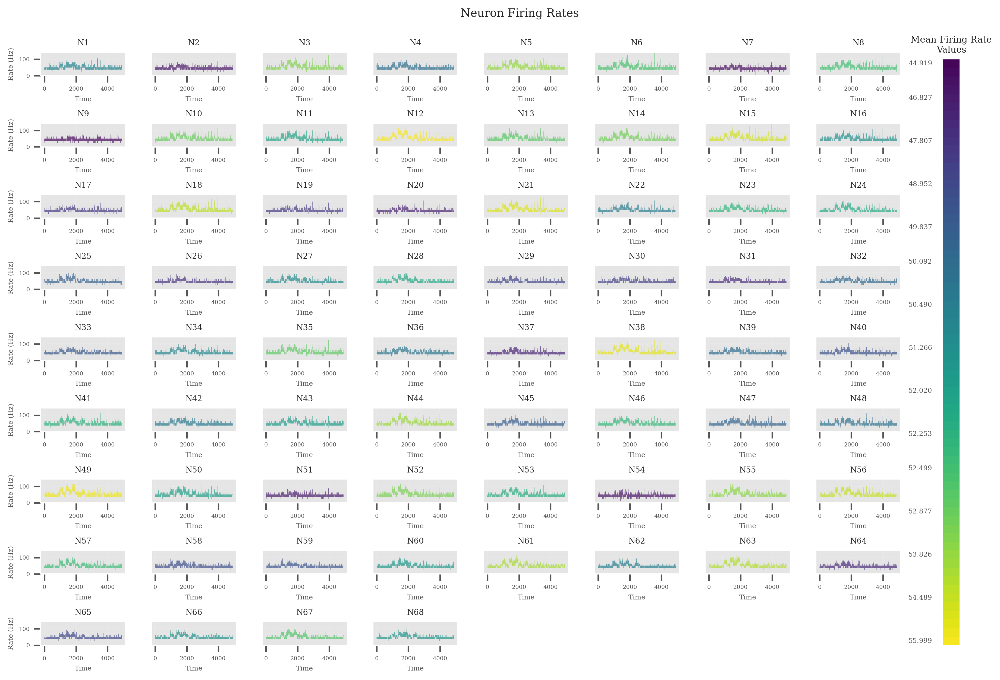

In [15]:
plot_neuron_firing_rate(
    rates_per_neuronPC, 
    column_name='Mean_Firing_Rate', 
    # title='Purkinje Neuron Firing Rates Colored by Mean Firing Rate',
    colors_raw=entire_mean_fr_scheme['colors_raw'],
    labels_data=entire_mean_fr_scheme['labels_data'],
    labels_display=entire_mean_fr_scheme['labels_display'],
    label_colors=entire_mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_stimulus)

In [16]:
def perform_ica(features, n_components=None, try_components=False):
    """
    Perform ICA without sorting components
    """
    features_centered = features - features.mean(axis=0)
    features_scaled = features_centered / features_centered.std(axis=0)

    if try_components:
        # PCA to find optimal number of components
        components = list(range(2, min(features_scaled.shape[1], 20) + 1, 2))
        components_var = []
        
        for comp in components:
            pca = PCA(n_components=comp, random_state=1, whiten=True)
            pca.fit(features_scaled)
            explained_variance = np.sum(pca.explained_variance_ratio_)
            print(f"Explained variance with {comp} components: {explained_variance:.4f}")
            components_var.append(explained_variance)
        
        plt.figure(figsize=(10, 6))
        plt.plot(components, components_var, marker='o')
        plt.xlabel('Number of Components')
        plt.ylabel('Cumulative Explained Variance Ratio')
        plt.title('PCA Explained Variance by Number of Components')
        plt.grid(True)
        plt.show()
        
        optimal_idx = next((i for i, var in enumerate(components_var) if var >= 0.90), len(components_var)-1)
        optimal_components = components[optimal_idx]
        print(f"Optimal number of components for 90% variance: {optimal_components}")
    else:
        optimal_components = n_components if n_components is not None else features.shape[1]

    ica = FastICA(n_components=optimal_components, random_state=1, max_iter=2000, tol=1e-4)

    try:
        ica_features = ica.fit_transform(features_scaled)
        print("ICA converged successfully")
    except Exception as e:
        print(f"ICA convergence failed: {e}")
        # Fallback to PCA if ICA fails
        pca = PCA(n_components=optimal_components, random_state=1, whiten=True)
        ica_features = pca.fit_transform(features_scaled)
        ica.mixing_ = pca.components_.T 
    
    print(f"ICA features shape: {ica_features.shape}")

    return ica_features, ica, ica.mixing_

ica_features_pc, ica, mixing_matrix = perform_ica(
    rates_per_neuronPC.T, n_components=2, try_components=False)

ICA converged successfully
ICA features shape: (4901, 2)


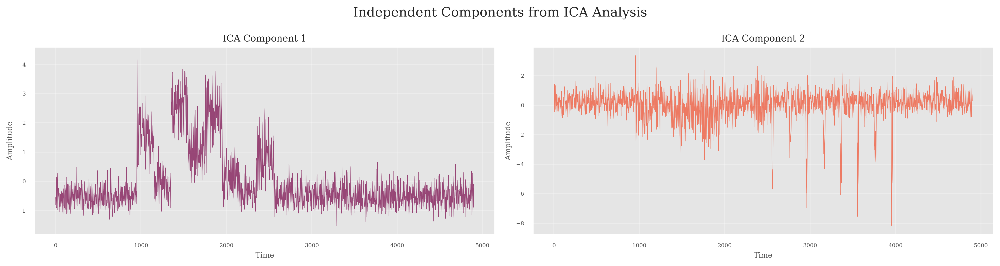

In [17]:
def plot_ICA_components(ica_features, n_components=5):
    """
    Plot the independent components obtained from ICA.
    """
    if n_components <= 5:
        rows, cols = 1, n_components
        figsize = (15, 4)
    elif n_components <= 10:
        rows, cols = 2, (n_components + 1) // 2
        figsize = (15, 8)
    else:
        rows = (n_components + 4) // 5
        cols = 5
        figsize = (15, rows * 3)
    
    fig, axes = plt.subplots(rows, cols, figsize=figsize, dpi=300)
    
    if rows == 1:
        axes = axes if n_components > 1 else [axes]
    else:
        axes = axes.flatten()

    colors_comp = sns.color_palette('rocket', n_colors=n_components)
    
    for i in range(n_components):
        axes[i].plot(ica_features[:, i], color=colors_comp[i], alpha=0.8, linewidth=0.5)
        axes[i].set_title(f'ICA Component {i+1}', fontsize=10)
        axes[i].set_xlabel('Time', fontsize=8)
        axes[i].set_ylabel('Amplitude', fontsize=8)
        axes[i].grid(True, alpha=0.3)
        axes[i].tick_params(axis='both', which='major', labelsize=6)
    for i in range(n_components, rows * cols):
        axes[i].axis('off')
    
    plt.suptitle('Independent Components from ICA Analysis', fontsize=14)
    plt.tight_layout()
    plt.show()

plot_ICA_components(ica_features_pc, n_components=ica_features_pc.shape[1])

In [18]:
# Create DataFrame from ICA features
# ica_features_df = pd.DataFrame(ica_features_pc, columns=[f'ICA_Component_{i+1}' for i in range(ica_features_pc.shape[1])])

# ica_features_df.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_features_entire_stimulus.csv', index=False)


In [19]:
def plot_mixing_matrix(mixing_matrix, n_components=5, cell_features_df=None, 
                      column_name='Mean_Firing_Rate', colors_raw=None, 
                      labels_data=None, labels_display=None, 
                      label_colors=None, add_annotations=True):
    """
    Plot the mixing matrix obtained from ICA.
    
    Parameters:
    - mixing_matrix: ICA mixing matrix (neurons x components)
    - n_components: Number of ICA components to plot
    - cell_features_df: DataFrame containing 'cell_id' and feature columns (e.g., foof_features_stimulus)
    - column_name: Column name in cell_features_df to use for coloring
    - colors_raw: Dictionary mapping feature values to colors
    - labels_data: Data for heatmap labels
    - labels_display: Display labels for heatmap
    - label_colors: List of colors for heatmap
    - add_annotations: Whether to add cell ID annotations
    """
    if label_colors is not None:
        custom_cmap_mean_fr = mcolors.ListedColormap(label_colors)
    else:
        custom_cmap_mean_fr = plt.cm.viridis
        
    fig = plt.figure(figsize=(12, 5), dpi=300)
    gs = GridSpec(1, 3, figure=fig, 
                  width_ratios=[2, 2, 0.3],
                  left=0.1, right=0.95, top=0.85, bottom=0.15, 
                  wspace=0.3)
    
    ax_scatter = fig.add_subplot(gs[0, 0])
    ax_mixing = fig.add_subplot(gs[0, 1])
    ax_heatmap = fig.add_subplot(gs[0, 2])
    
    for i in range(n_components):
        colors_comp = sns.color_palette('viridis', n_colors=n_components)
        ax_mixing.plot(mixing_matrix[:, i], label=f'Component {i+1}', alpha=0.7, color=colors_comp[i])
    
    ax_mixing.set_title('ICA Mixing Matrix')
    ax_mixing.set_xlabel('Neuron Index')
    ax_mixing.set_ylabel('Mixing Coefficients')
    ax_mixing.grid(True, alpha=0.3)
    ax_mixing.set_xticks(np.arange(0, mixing_matrix.shape[0], 10))
    ax_mixing.legend()

    print(f"Shape of mixing matrix: {mixing_matrix.shape}")
    
    # neurons scatter plot in ICA space colored by feature values
    if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
        neuron_colors = []
        for i in range(len(mixing_matrix)):
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    value_idx = np.argmin(np.abs(np.array(list(colors_raw.keys())) - feature_value))
                    closest_value = list(colors_raw.keys())[value_idx]
                    neuron_colors.append(colors_raw[closest_value])
            else:
                neuron_colors.append('gray') 
        
        scatter = ax_scatter.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                                   c=neuron_colors, alpha=0.8, s=50, edgecolors='black', linewidth=0.5)
        
        if add_annotations:
            for i in range(len(mixing_matrix)):
                if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
                    if i < len(cell_features_df):
                        annotation_text = str(int(cell_features_df.iloc[i]['cell_id']))
                    else:
                        annotation_text = str(i) 
                else:
                    annotation_text = str(i)  
                    
                ax_scatter.annotate(annotation_text, 
                                  (mixing_matrix[i, 0], mixing_matrix[i, 1]),
                                  fontsize=6, alpha=0.8, color='black',
                                  textcoords='offset points', xytext=(2,2))
    else:
        ax_scatter.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], alpha=0.5, s=50, color='blue')
        
        if add_annotations and cell_features_df is not None and 'cell_id' in cell_features_df.columns:
            for i in range(len(mixing_matrix)):
                if i < len(cell_features_df):
                    annotation_text = str(int(cell_features_df.iloc[i]['cell_id']))
                else:
                    annotation_text = str(i)
                    
                ax_scatter.annotate(annotation_text, 
                                  (mixing_matrix[i, 0], mixing_matrix[i, 1]),
                                  fontsize=6, alpha=0.8, color='black',
                                  textcoords='offset points', xytext=(2,2))
    
    ax_scatter.set_title('Neurons in ICA Space')
    ax_scatter.set_xlabel('ICA Component 1')
    ax_scatter.set_ylabel('ICA Component 2')
    ax_scatter.grid(True, alpha=0.3)
    
    # Colorbar heatmap
    if labels_data is not None and labels_display is not None and label_colors is not None:
        sns.heatmap(data=labels_data, ax=ax_heatmap, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        ax_heatmap.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=10)
        ax_heatmap.tick_params(axis='y', labelsize=7)

    fig.suptitle(f'ICA Analysis: Mixing Matrix and Neurons in ICA Space colored by {column_name.replace("_", " ").title()}', fontsize=14)
    plt.show()

In [20]:
def plot_mixing_matrix(mixing_matrix, n_components=5, cell_features_df=None, 
                      column_name='Mean_Firing_Rate', colors_raw=None, 
                      labels_data=None, labels_display=None, 
                      label_colors=None, add_annotations=True):
    """
    Plot the mixing matrix obtained from ICA.
    
    Parameters:
    - mixing_matrix: ICA mixing matrix (neurons x components)
    - n_components: Number of ICA components to plot
    - cell_features_df: DataFrame containing 'cell_id' and feature columns (e.g., foof_features_stimulus)
    - column_name: Column name in cell_features_df to use for coloring
    - colors_raw: Dictionary mapping feature values to colors
    - labels_data: Data for heatmap labels
    - labels_display: Display labels for heatmap
    - label_colors: List of colors for heatmap
    - add_annotations: Whether to add cell ID annotations
    """
    from mpl_toolkits.mplot3d import Axes3D
    
    if label_colors is not None:
        custom_cmap_mean_fr = mcolors.ListedColormap(label_colors)
    else:
        custom_cmap_mean_fr = plt.cm.viridis
    
    # Check if we should use 3D plotting
    use_3d = (mixing_matrix.shape[1] >= 3 and n_components >= 3)
    
    if use_3d:
        fig = plt.figure(figsize=(15, 5), dpi=300)
        gs = GridSpec(1, 3, figure=fig, 
                      width_ratios=[2, 2, 0.6],
                      left=0.1, right=0.95, top=0.85, bottom=0.15, 
                      wspace=0.3)
        
        ax_scatter = fig.add_subplot(gs[0, 0], projection='3d')
    else:
        fig = plt.figure(figsize=(12, 5), dpi=300)
        gs = GridSpec(1, 3, figure=fig, 
                      width_ratios=[2, 2, 0.15],
                      left=0.1, right=0.95, top=0.85, bottom=0.15, 
                      wspace=0.3)
        
        ax_scatter = fig.add_subplot(gs[0, 0])
    
    ax_mixing = fig.add_subplot(gs[0, 1])
    ax_heatmap = fig.add_subplot(gs[0, 2])
    
    # Plot mixing matrix
    for i in range(min(n_components, mixing_matrix.shape[1])):
        colors_comp = sns.color_palette('magma', n_colors=min(n_components, mixing_matrix.shape[1]))
        ax_mixing.plot(mixing_matrix[:, i], label=f'Component {i+1}', alpha=0.7, color=colors_comp[i])
    
    ax_mixing.set_title('ICA Mixing Matrix')
    ax_mixing.set_xlabel('Neuron Index')
    ax_mixing.set_ylabel('Mixing Coefficients')
    ax_mixing.grid(True, alpha=0.3)
    ax_mixing.set_xticks(np.arange(0, mixing_matrix.shape[0], 10))
    ax_mixing.legend()

    print(f"Shape of mixing matrix: {mixing_matrix.shape}")
    print(f"Using {'3D' if use_3d else '2D'} scatter plot")
    
    # Prepare neuron colors
    if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
        neuron_colors = []
        for i in range(len(mixing_matrix)):
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    value_idx = np.argmin(np.abs(np.array(list(colors_raw.keys())) - feature_value))
                    closest_value = list(colors_raw.keys())[value_idx]
                    neuron_colors.append(colors_raw[closest_value])
            else:
                neuron_colors.append('gray') 
    else:
        neuron_colors = ['blue'] * len(mixing_matrix)
    
    # Create scatter plot (2D or 3D)
    if use_3d:
        scatter = ax_scatter.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], mixing_matrix[:, 2],
                                   c=neuron_colors, alpha=0.8, s=50, edgecolors='black', linewidth=0.5)
        
        ax_scatter.set_xlabel('ICA Component 1')
        ax_scatter.set_ylabel('ICA Component 2')
        ax_scatter.set_zlabel('ICA Component 3')
        ax_scatter.set_title('Neurons in 3D ICA Space')
        
        if add_annotations:
            for i in range(len(mixing_matrix)):
                if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
                    if i < len(cell_features_df):
                        annotation_text = str(int(cell_features_df.iloc[i]['cell_id']))
                    else:
                        annotation_text = str(i) 
                else:
                    annotation_text = str(i)  
                    
                ax_scatter.text(mixing_matrix[i, 0], mixing_matrix[i, 1], mixing_matrix[i, 2],
                              annotation_text, fontsize=6, alpha=0.8, color='black')
    else:
        scatter = ax_scatter.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                                   c=neuron_colors, alpha=0.8, s=50, edgecolors='black', linewidth=0.5)
        
        ax_scatter.set_xlabel('ICA Component 1')
        ax_scatter.set_ylabel('ICA Component 2')
        ax_scatter.set_title('Neurons in 2D ICA Space')
        ax_scatter.grid(True, alpha=0.3)
        
        # 2D annotations
        if add_annotations:
            for i in range(len(mixing_matrix)):
                if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
                    if i < len(cell_features_df):
                        annotation_text = str(int(cell_features_df.iloc[i]['cell_id']))
                    else:
                        annotation_text = str(i) 
                else:
                    annotation_text = str(i)  
                    
                ax_scatter.annotate(annotation_text, 
                                  (mixing_matrix[i, 0], mixing_matrix[i, 1]),
                                  fontsize=6, alpha=0.8, color='black',
                                  textcoords='offset points', xytext=(2,2))
    
    # Colorbar heatmap
    if labels_data is not None and labels_display is not None and label_colors is not None:
        sns.heatmap(data=labels_data, ax=ax_heatmap, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        ax_heatmap.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=10)
        ax_heatmap.tick_params(axis='y', labelsize=7)

    # Set appropriate title
    space_type = "3D" if use_3d else "2D"
    fig.suptitle(f'ICA Analysis: Mixing Matrix and Neurons in {space_type} ICA Space colored by {column_name.replace("_", " ").title()}', fontsize=14)
    plt.show()

In [21]:
mixing_matrix.shape

(68, 2)

Shape of mixing matrix: (68, 2)
Using 2D scatter plot


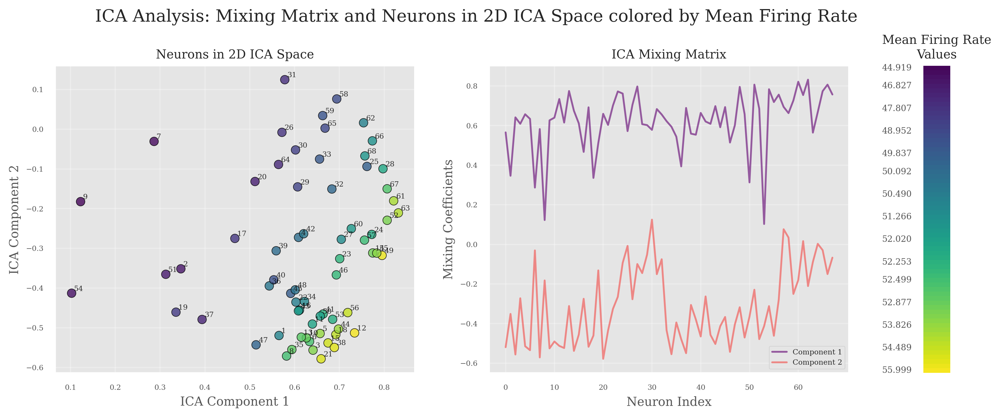

In [22]:
plot_mixing_matrix(
    mixing_matrix=mixing_matrix, 
    n_components=2,
    cell_features_df=foof_features_stimulus,
    column_name='Mean_Firing_Rate',
    colors_raw=entire_mean_fr_scheme['colors_raw'],
    labels_data=entire_mean_fr_scheme['labels_data'],
    labels_display=entire_mean_fr_scheme['labels_display'],
    label_colors=entire_mean_fr_scheme['label_colors'],
    add_annotations=True
)

In [23]:
def plot_ica_projections_stimulus_clusters(mixing_matrix, cluster_labels, title='ICA Projections: Stimulus Clusters', 
                                          figsize=(10, 6), add_annotations=True, cluster_method='K-means',
                                          cell_features_df=None):
    """
    Plot neurons in ICA space colored by cluster assignments from the entire stimulus period
    
    Parameters:
    - mixing_matrix: ICA mixing matrix (neurons x components)
    - cluster_labels: Cluster assignment vector for all neurons
    - title: Plot title
    - figsize: Figure size tuple
    - add_annotations: Whether to add neuron ID annotations
    - cluster_method: Name of clustering method for legend
    - cell_features_df: DataFrame containing 'cell_id' column for annotations
    """
    
    fig, ax = plt.subplots(figsize=figsize, dpi=300)
    
    # Get unique clusters
    unique_clusters = np.unique(cluster_labels)
    
    # Define colors for clusters
    if len(unique_clusters) == 2:
        cluster_colors = ['blue', 'red']
        cluster_names = ['Cluster 0 (OFF)', 'Cluster 1 (ON)']
    else:
        cluster_colors = plt.cm.get_cmap('tab10', len(unique_clusters))
        cluster_names = [f'Cluster {i}' for i in unique_clusters]
    
    # Plot each cluster
    for i, cluster in enumerate(unique_clusters):
        cluster_indices = np.where(cluster_labels == cluster)[0]
        color = cluster_colors[i] if len(unique_clusters) == 2 else cluster_colors(cluster)
        
        ax.scatter(mixing_matrix[cluster_indices, 0], mixing_matrix[cluster_indices, 1], 
                  alpha=0.8, s=60, label=cluster_names[i], color=color,
                  edgecolors='black', linewidth=0.5)
    
    if add_annotations:
        for neuron_idx in range(len(mixing_matrix)):
            # Use cell_id if available, otherwise use neuron index
            if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
                if neuron_idx < len(cell_features_df):
                    annotation_text = str(int(cell_features_df.iloc[neuron_idx]['cell_id']))
                else:
                    annotation_text = str(neuron_idx)
            else:
                annotation_text = str(neuron_idx)
                
            ax.annotate(annotation_text, 
                       (mixing_matrix[neuron_idx, 0], mixing_matrix[neuron_idx, 1]),
                       fontsize=8, alpha=0.8, color='black',
                       textcoords='offset points', xytext=(3,3))
    
    ax.set_xlabel('ICA Component 1', fontsize=12)
    ax.set_ylabel('ICA Component 2', fontsize=12)
    ax.set_title(f'{title}\n({cluster_method} Clustering)', fontsize=14)
    ax.grid(True, alpha=0.3)
    ax.legend(fontsize=10, framealpha=0.8, loc='best')
    
    plt.tight_layout()
    plt.show()

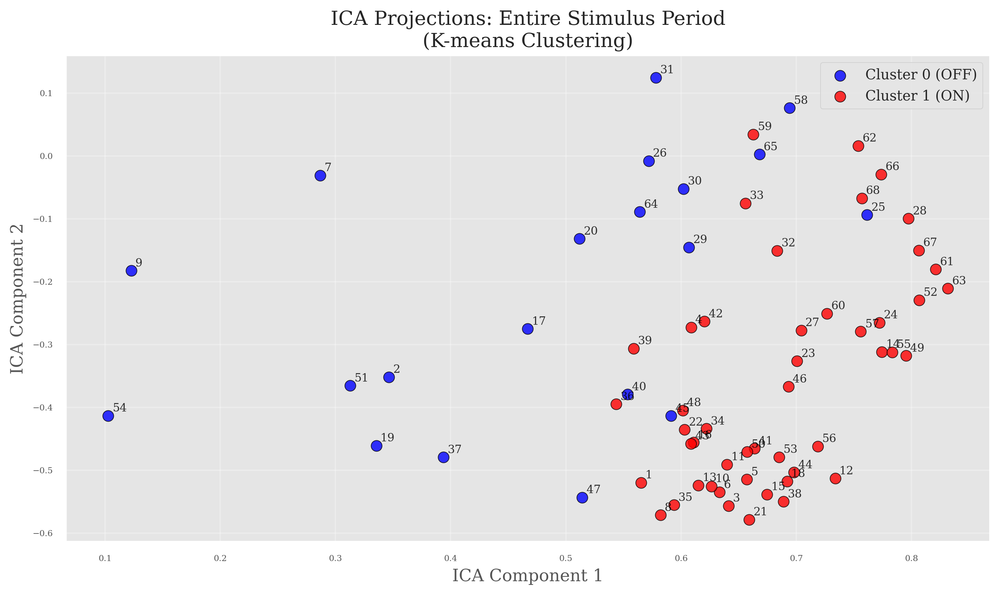

In [24]:
plot_ica_projections_stimulus_clusters(
    mixing_matrix=mixing_matrix, 
    cluster_labels=labels_stimulus,
    title='ICA Projections: Entire Stimulus Period',
    cluster_method='K-means',
    add_annotations=True,
    cell_features_df=foof_features_stimulus 
)

In [25]:
#ica_features_pc, ica, mixing_matrix = perform_ica(
#    rates_per_neuronPC.T, n_components=None, try_components=False)

# plot_ICA_components(ica_features_pc, n_components=ica_features_pc.shape[1])


# ICA for each condition

Coefficient of Variation: 0.1057
Mean ISI: 21.4979 +- 2.2713 ms
Min ISI: 5.9000 ms, Max ISI: 29.9000 ms
Duration of the interval: 5000 ms
Spikes in interval: 15823
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.4721+/-1.1647
Max firing rate: 50.0000
Min firing rate: 43.4743
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 21.4979 +- 2.2713 ms
Min ISI: 5.9000 ms, Max ISI: 29.9000 ms
Coefficient of Variation: 0.1057


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


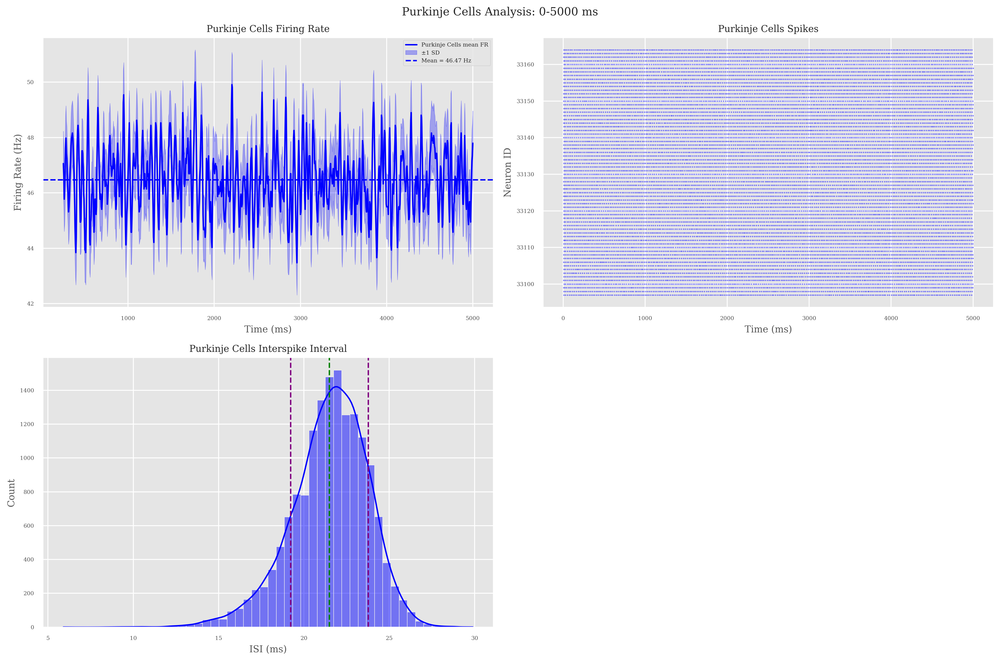

In [26]:
rates_per_neuronPC_baseline1, time_mask_baseline1, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(0, 5000),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)


Coefficient of Variation: 0.1036
Mean ISI: 21.4793 +- 2.2249 ms
Min ISI: 9.8000 ms, Max ISI: 29.1000 ms
Duration of the interval: 4900.0 ms
Spikes in interval: 15511
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.5548+/-1.2102
Max firing rate: 50.0919
Min firing rate: 41.0846
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 21.4793 +- 2.2249 ms
Min ISI: 9.8000 ms, Max ISI: 29.1000 ms
Coefficient of Variation: 0.1036


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


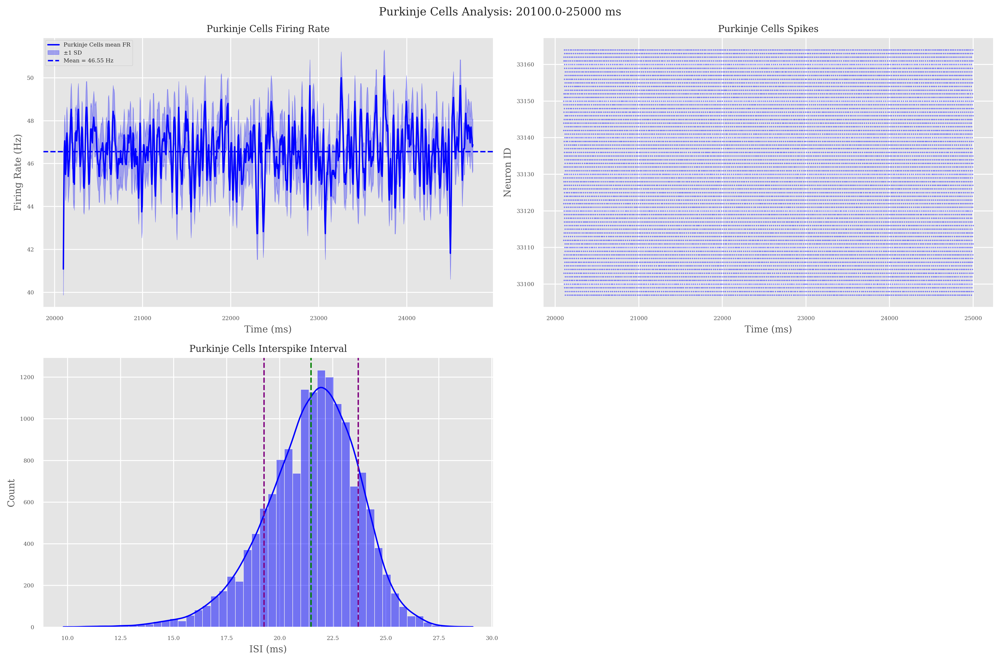

In [27]:
rates_per_neuronPC_baseline2, time_mask_baseline2, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(20100.0, 25000),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)

Shape of baseline rates per neuron for Purkinje Cells: (1882,)
Mean firing rate for Purkinje Cells in baseline: (1882,)
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 46.5130+/-1.1881
Max firing rate: 50.0919
Min firing rate: 41.0846


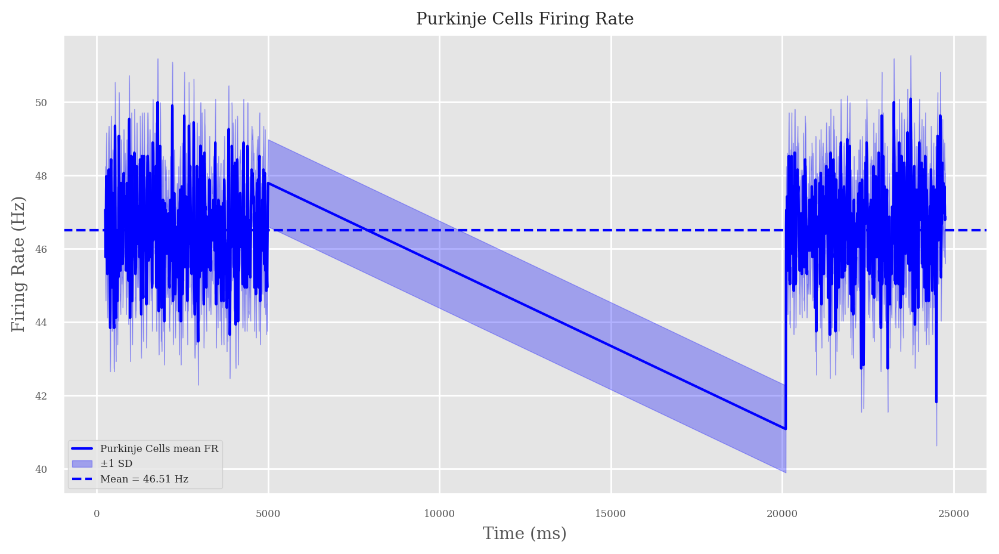

In [28]:
baseline_rates_per_neuronPC = np.hstack((rates_per_neuronPC_baseline1, rates_per_neuronPC_baseline2))
time_mask_b= np.hstack((time_mask_baseline1, time_mask_baseline2))
time_vector_b = np.hstack((times_vectorPC[time_mask_baseline1], times_vectorPC[time_mask_baseline2]))

print("Shape of baseline rates per neuron for Purkinje Cells:", time_vector_b.shape)
mean_ratePC_baseline = np.mean(baseline_rates_per_neuronPC, axis=0)
print("Mean firing rate for Purkinje Cells in baseline:", mean_ratePC_baseline.shape)
fig, ax = plt.subplots(figsize=(10, 5))
plot_firing_rate(time_vector_b, mean_ratePC_baseline, ax=ax, pop='Purkinje Cells', color='blue')

Global y-axis range: 21.88 to 90.62 Hz


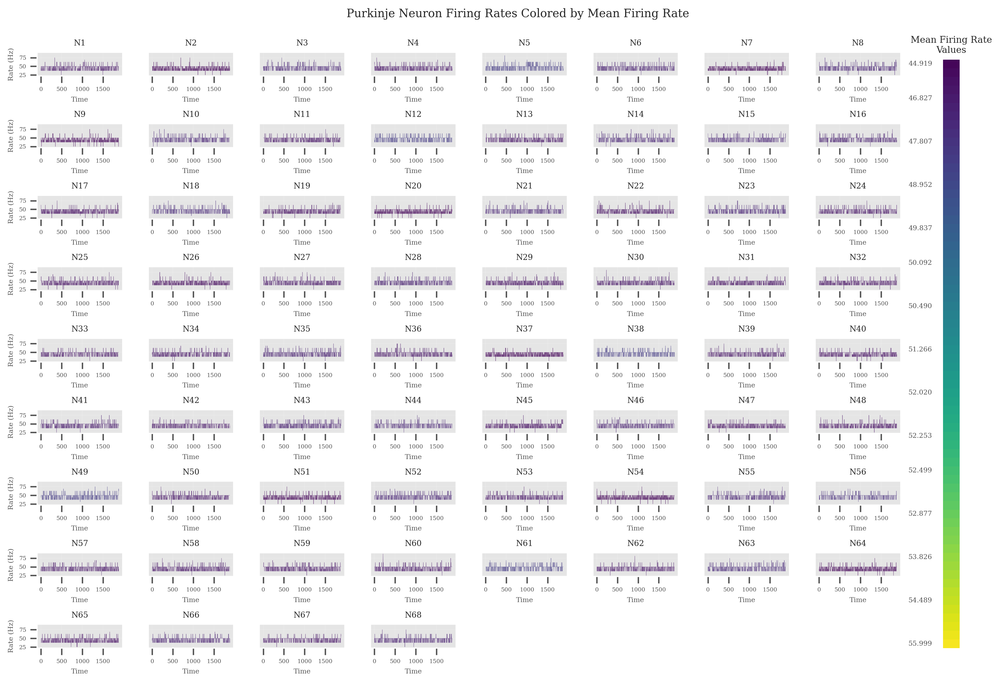

In [29]:
plot_neuron_firing_rate(
    baseline_rates_per_neuronPC, 
    column_name='Mean_Firing_Rate', 
    title='Purkinje Neuron Firing Rates Colored by Mean Firing Rate',
    colors_raw=entire_mean_fr_scheme['colors_raw'],
    labels_data=entire_mean_fr_scheme['labels_data'],
    labels_display=entire_mean_fr_scheme['labels_display'],
    label_colors=entire_mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_baseline)

In [30]:
ica_features_pc_base, ica_base, mixing_matrix_baseline = perform_ica(baseline_rates_per_neuronPC.T, n_components=2, try_components=False)

ICA converged successfully
ICA features shape: (1882, 2)


/home/nix/miniconda3/envs/pytorch_env/lib/python3.12/site-packages/sklearn/decomposition/_fastica.py:127: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


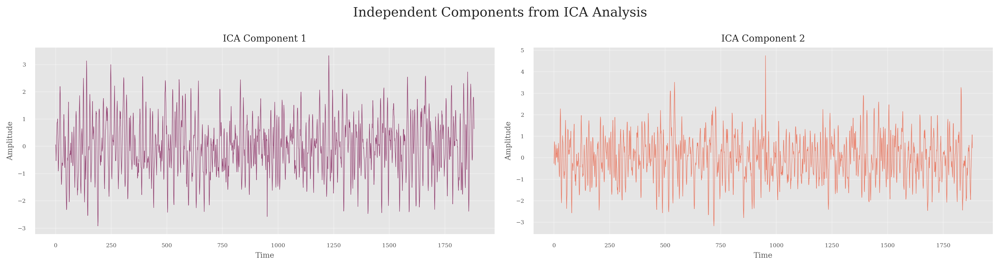

In [31]:
plot_ICA_components(ica_features_pc_base, n_components=ica_features_pc_base.shape[1])

Shape of mixing matrix: (68, 2)
Using 2D scatter plot


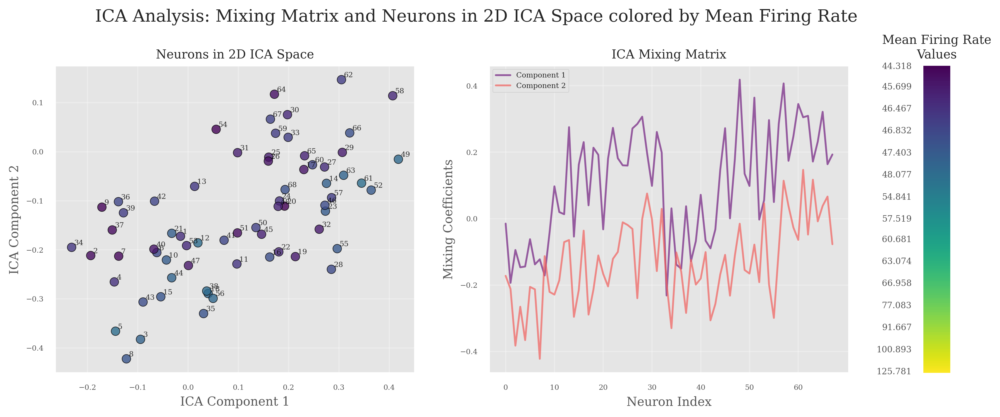

In [32]:
plot_mixing_matrix(
    mixing_matrix=mixing_matrix_baseline, 
    n_components=2,
    cell_features_df=foof_features_baseline,
    column_name='Mean_Firing_Rate',
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    add_annotations=True
)

## Step Stimulus

Coefficient of Variation: 0.2218
Mean ISI: 17.0248 +- 3.7764 ms
Min ISI: 4.1000 ms, Max ISI: 32.1000 ms
Duration of the interval: 8000.0 ms
Spikes in interval: 31943
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 58.7223+/-8.6993
Max firing rate: 78.0331
Min firing rate: 44.2096
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 17.0248 +- 3.7764 ms
Min ISI: 4.1000 ms, Max ISI: 32.1000 ms
Coefficient of Variation: 0.2218


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


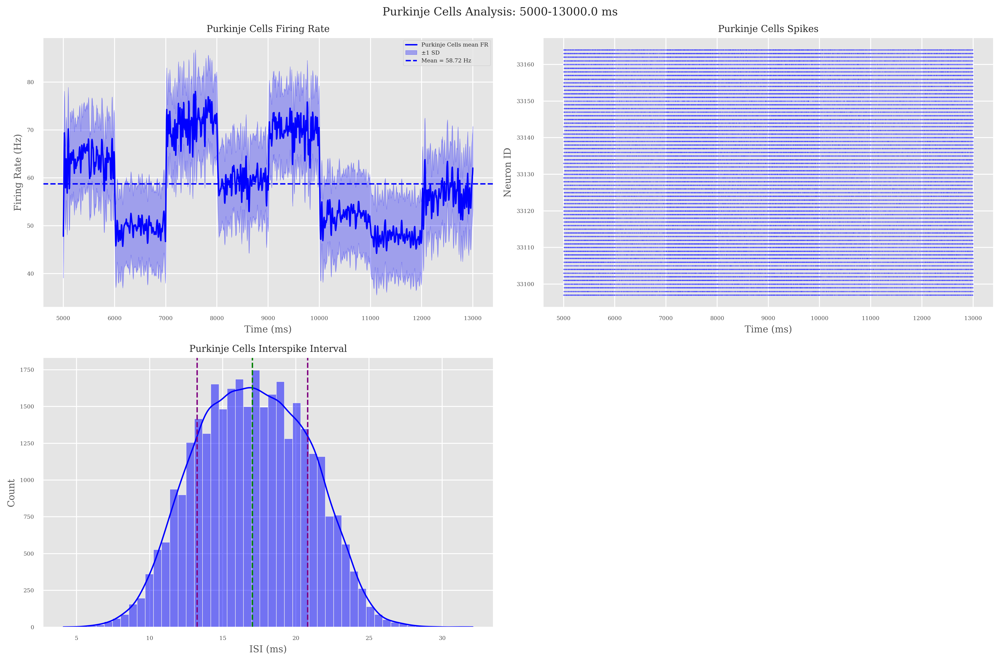

In [33]:
rates_per_neuronPC_stimulus_step, time_mask_stimulus_step, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(5000, 13000.0),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)

Global y-axis range: 6.88 to 130.62 Hz


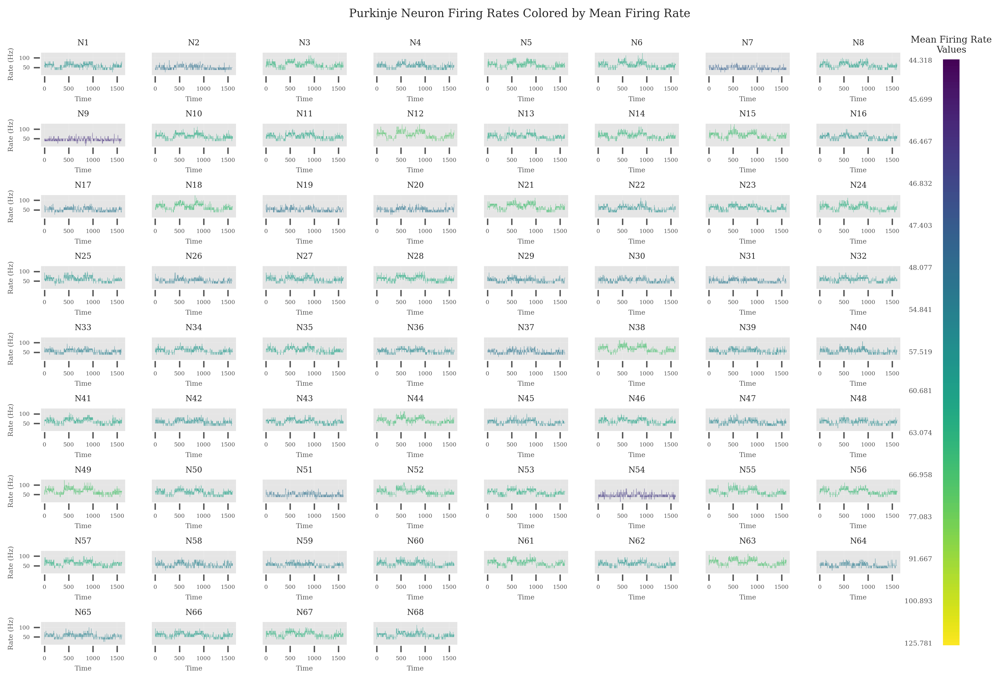

In [34]:
plot_neuron_firing_rate(
    rates_per_neuronPC_stimulus_step, 
    column_name='Mean_Firing_Rate', 
    title='Purkinje Neuron Firing Rates Colored by Mean Firing Rate',
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_step)

In [35]:
ica_features_pc_step, ica_step, mixing_matrix_step = perform_ica(rates_per_neuronPC_stimulus_step.T, n_components=2, try_components=False)

ICA converged successfully
ICA features shape: (1601, 2)


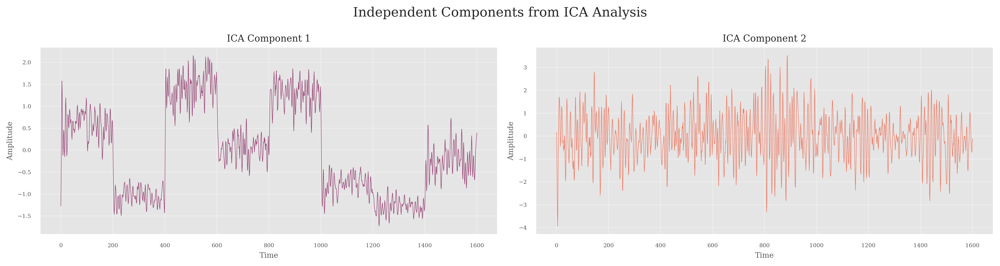

In [36]:
plot_ICA_components(ica_features_pc_step, n_components=ica_features_pc_step.shape[1])

In [37]:
# Create DataFrame from ICA features
ica_features_step_df = pd.DataFrame(ica_features_pc_step, columns=[f'ICA_Component_{i+1}' for i in range(ica_features_pc_step.shape[1])])

ica_features_step_df.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_features_step.csv', index=False)


Shape of mixing matrix: (68, 2)
Using 2D scatter plot


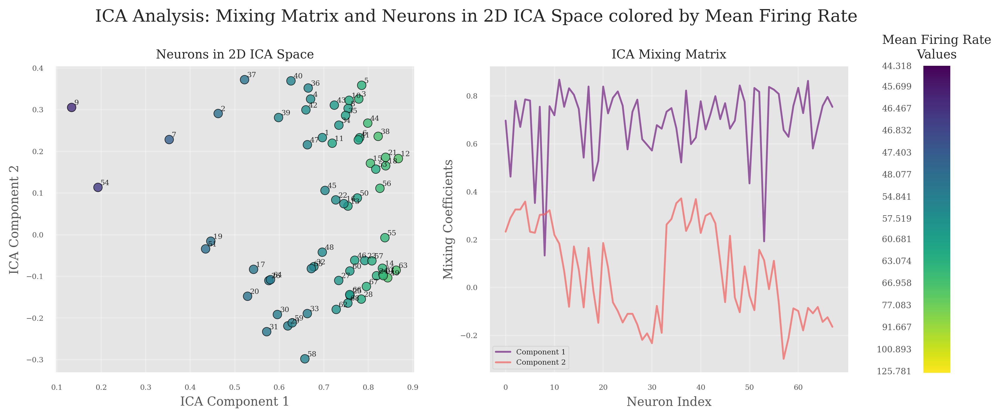

In [38]:
plot_mixing_matrix(
    mixing_matrix=mixing_matrix_step, 
    n_components=2,
    cell_features_df=foof_features_step,
    column_name='Mean_Firing_Rate',
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    add_annotations=True
)

# Burst Stimulus

Coefficient of Variation: 0.1627
Mean ISI: 20.7096 +- 3.3696 ms
Min ISI: 3.2000 ms, Max ISI: 41.2000 ms
Duration of the interval: 7100.0 ms
Spikes in interval: 23313
------------------------------------------------------------
📊 Statistics for population Purkinje Cells:
Mean firing rate: 48.2868+/-5.6310
Max firing rate: 83.5478
Min firing rate: 39.9816
------------------------------------------------------------
📊 Statistics of Interspike intervals for population Purkinje Cells:
Mean ISI: 20.7096 +- 3.3696 ms
Min ISI: 3.2000 ms, Max ISI: 41.2000 ms
Coefficient of Variation: 0.1627


/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/utils.py:248: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


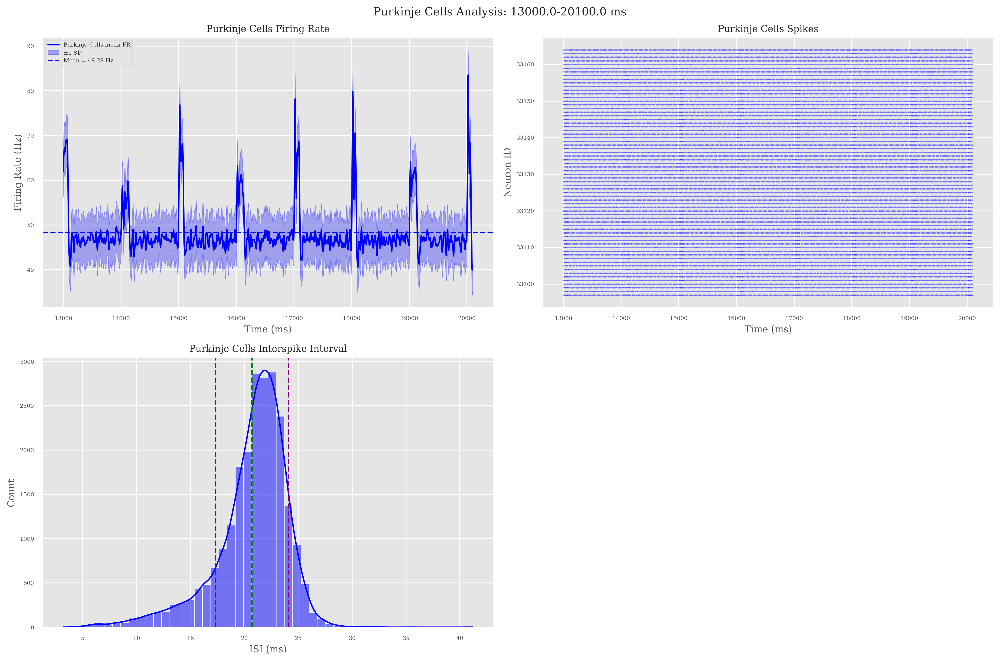

In [39]:
rates_per_neuronPC_burst, time_mask_burst, interval_spikes, isi_dict, isi_stats = extract_fr(
    spiking_data=df_spikes,
    times_vector=times_vectorPC,
    rates_per_neuron=rates_per_neuronPC,
    mean_rate=mean_ratePC,
    time_interval=(13000.0, 20100.0),
    pop='Purkinje Cells',
    color='blue',
    plot=True
)

In [40]:
foof_features_burst

,x,y,z,cell_type,cell_id,Peak1_Freq,Peak1_Power,Peak1_Bandwidth,Aperiodic_Offset,Aperiodic_Exponent,...,Mean_Phase,Std_Phase,Mean_Firing_Rate,Total_Energy,Total_Inh_Synapses,Total_Exc_Synapses,Total_Weighted_Synapses,ICA_Component_1,ICA_Component_2,pc_MLI_correlations
0,75.622307,9.909550,137.5,purkinje_cell,1,3720.694081,3.411780,19.531250,5.828951,3.407485,...,240.550089,1.732597,96.250000,99.160569,60,1634,106.42,0.775957,-0.018882,0.348388
1,33.403757,22.655929,137.5,purkinje_cell,2,1499.538922,3.837472,35.577480,5.645343,3.411423,...,339.402549,1.896604,72.767857,28.099232,60,1634,106.42,0.394933,-0.112094,0.162214
2,69.794482,30.924364,137.5,purkinje_cell,3,3278.268771,3.454449,19.531254,5.952298,3.414187,...,174.970526,1.498215,107.142857,130.132085,60,1634,106.42,0.831609,-0.058028,0.436820
3,12.575932,44.695208,137.5,purkinje_cell,4,1827.049765,3.494904,48.903861,4.563415,3.038568,...,358.741312,1.979603,71.250000,11.353846,60,1633,106.22,0.256699,-0.086096,0.172845
4,48.966657,50.266964,137.5,purkinje_cell,5,1377.143201,3.094212,87.790839,6.096627,3.445887,...,167.839537,1.529263,97.916667,66.112614,60,1633,106.22,0.774386,-0.123286,0.431757
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,256.218257,151.264113,137.5,purkinje_cell,64,3974.256633,3.413289,28.059724,4.450291,3.017634,...,3.924229,1.963678,68.750000,16.412934,44,1319,83.75,0.258535,0.039537,0.090484
64,235.390432,169.972894,137.5,purkinje_cell,65,3556.731800,3.484549,75.613920,4.707765,3.084405,...,357.745610,1.936412,72.321429,54.766807,44,1319,83.75,-0.006199,0.216675,-0.016934
65,271.781157,179.113473,137.5,purkinje_cell,66,3883.079730,3.436681,19.531250,4.235914,2.928167,...,6.321080,1.961643,70.000000,39.549659,43,1319,83.58,0.128338,0.365428,0.167182
66,229.562607,188.721073,137.5,purkinje_cell,67,3554.674817,3.479888,33.201621,5.040569,3.129291,...,9.198384,1.927250,77.500000,31.459187,43,1319,83.58,0.401027,0.281084,0.300921


In [41]:
def plot_neuron_firing_rate(rates_per_neuron, column_name='Mean_Firing_Rate', 
                          title='Neuron Firing Rates', figsize=(8.27, 10), rows=9, cols=8,
                          colors_raw=None, labels_data=None, labels_display=None, 
                          label_colors=None, cell_features_df=None):
    """
    Plot individual neuron firing rates colored by a specified feature with colorbar.
    """
    custom_cmap_mean_fr = mcolors.ListedColormap(label_colors) if label_colors else plt.cm.viridis
    
    fig = plt.figure(figsize=figsize, dpi=300)
    gs_main = GridSpec(1, 2, figure=fig, 
                       width_ratios=[12, 0.3],
                       left=0.08, right=0.95, top=0.90, bottom=0.10, 
                       wspace=0.02)
    
    ax_main = fig.add_subplot(gs_main[0, 0])
    ax_main.set_visible(False)
    
    # Adjusted spacing for square format - increased hspace to prevent title overlap
    gs_neurons = GridSpec(rows, cols, figure=fig, 
                         left=0.08, right=0.83, top=0.88, bottom=0.10,
                         hspace=1.0, wspace=0.3)  # Increased hspace from 0.8 to 1.0
    
    ax_heatmap = fig.add_subplot(gs_main[0, 1])
    
    # Calculate global y-axis limits for all neurons
    y_min = np.min(rates_per_neuron)
    y_max = np.max(rates_per_neuron)
    y_range = y_max - y_min
    y_margin = y_range * 0.05
    global_ylim = (y_min - y_margin, y_max + y_margin)
    
    # Colors for each neuron based on feature values
    neuron_colors = []
    for i in range(len(rates_per_neuron)):
        if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    color_keys = np.array(list(colors_raw.keys()))
                    if np.isfinite(feature_value):
                        value_idx = np.argmin(np.abs(color_keys - feature_value))
                        closest_value = color_keys[value_idx]
                        neuron_colors.append(colors_raw[closest_value])
                    else:
                        neuron_colors.append('gray')
            else:
                neuron_colors.append('gray')
        else:
            neuron_colors.append('blue')
    
    all_neuron_axes = []
    n_neurons = len(rates_per_neuron)
    
    for i in range(n_neurons):
        row = i // cols
        col = i % cols
        ax = fig.add_subplot(gs_neurons[row, col])
        all_neuron_axes.append(ax)
        
        ax.plot(rates_per_neuron[i], color=neuron_colors[i], alpha=0.7, linewidth=0.2)
        
        # Use cell_id if provided, otherwise use default numbering
        if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
            if i < len(cell_features_df):
                neuron_name = f'N{int(cell_features_df.iloc[i]["cell_id"])}'
            else:
                neuron_name = f'N{i+1}'
        else:
            neuron_name = f'N{i+1}'
        
        # Fixed title overlap by adding proper padding and reducing font size
        ax.set_title(neuron_name, fontsize=6, pad=8)  # Increased pad from default to 8
        
        # Y-axis: Only show on first column
        if col == 0:
            ax.set_ylabel('Rate (Hz)', fontsize=5)  # Reduced font size
            ax.tick_params(axis='y', which='major', labelsize=4, left=True, labelleft=True)
        else:
            # Hide y-axis labels and ticks for other columns
            ax.set_yticklabels([])
            ax.tick_params(axis='y', which='both', left=False, labelleft=False)
            
        # X-axis: Show on all subplots with more ticks
        ax.set_xlabel('Time', fontsize=5)  # Reduced font size
        ax.tick_params(axis='x', which='major', labelsize=4, bottom=True, labelbottom=True)
        
        # Set more x-axis ticks to show "most of the ticks"
        ax.tick_params(axis='x', which='minor', bottom=True, labelbottom=False, length=2)
            
        ax.grid(True, alpha=0.1)
        ax.set_ylim(global_ylim)
    
    # Print y-axis range for reference
    print(f"Global y-axis range: {global_ylim[0]:.2f} to {global_ylim[1]:.2f} Hz")
    
    # Colorbar heatmap - adjusted for square format
    if labels_data is not None and labels_display is not None:
        sns.heatmap(data=labels_data, ax=ax_heatmap, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        ax_heatmap.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=7)  # Reduced font size
        ax_heatmap.tick_params(axis='y', labelsize=5, rotation=0)  # Reduced font size
    
    fig.suptitle(title, fontsize=9, y=0.94)
    plt.show()


Global y-axis range: -0.31 to 144.06 Hz


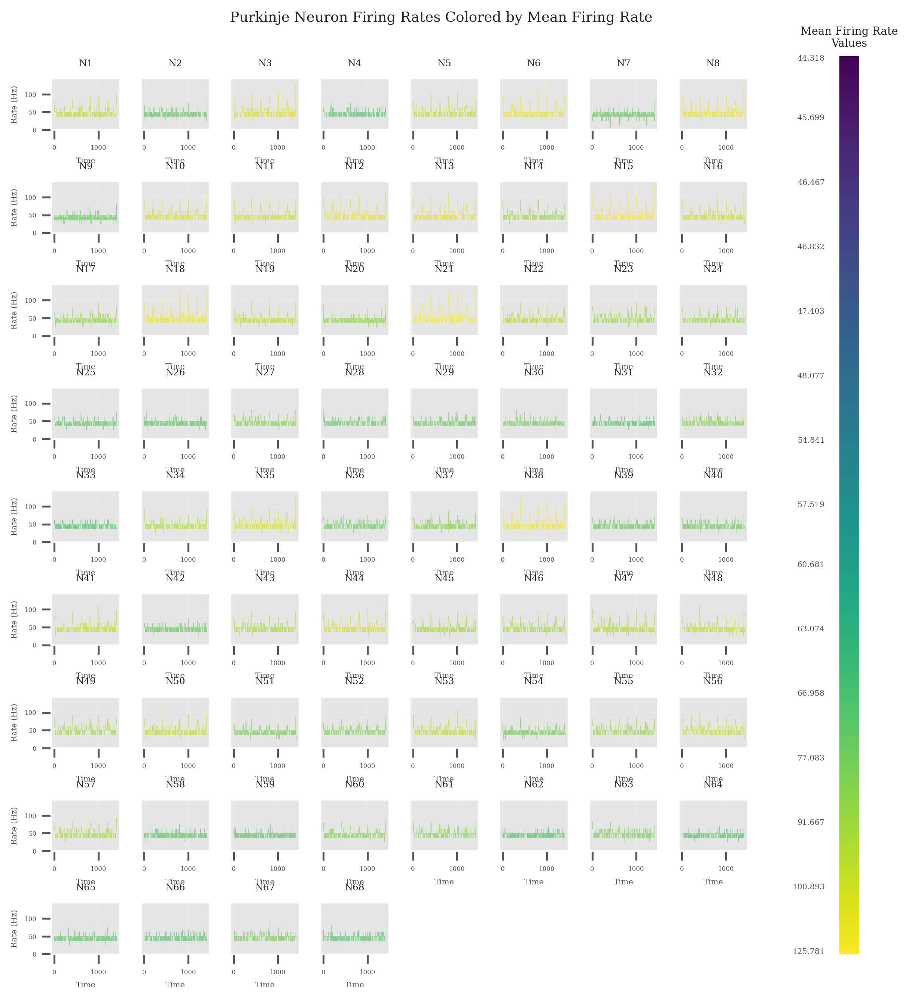

In [42]:
plot_neuron_firing_rate(
    rates_per_neuronPC_burst, 
    column_name='Mean_Firing_Rate', 
    title='Purkinje Neuron Firing Rates Colored by Mean Firing Rate',
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_burst)

In [43]:
def plot_neuron_firing_rate(rates_per_neuron, column_name='Mean_Firing_Rate', 
                          title='Neuron Firing Rates', figsize=(8.27, 10), rows=9, cols=8,
                          colors_raw=None, labels_data=None, labels_display=None, 
                          label_colors=None, cell_features_df=None, fig=None, 
                          neuron_axes=None, heatmap_ax=None):
    """
    Plot individual neuron firing rates colored by a specified feature with colorbar.
    
    Parameters:
    - rates_per_neuron: Array/DataFrame with firing rates per neuron (neurons x time)
    - column_name: Column name in cell_features_df to use for coloring (e.g., 'Mean_Firing_Rate')
    - title: Main title for the plot
    - figsize: Figure size tuple (only used if fig is None)
    - rows, cols: Grid layout for subplots
    - colors_raw: Dictionary mapping feature values to colors
    - labels_data: Data for heatmap labels
    - labels_display: Display labels for heatmap
    - label_colors: List of colors for heatmap
    - cell_features_df: DataFrame containing 'cell_id' and feature columns
    - fig: Optional external figure object
    - neuron_axes: Optional list of axes for neuron subplots (must have rows*cols elements)
    - heatmap_ax: Optional external axis for heatmap colorbar
    
    Returns:
    - fig: Figure object
    - neuron_axes: List of neuron subplot axes
    - heatmap_ax: Heatmap axis (if created or provided)
    """
    custom_cmap_mean_fr = mcolors.ListedColormap(label_colors) if label_colors else plt.cm.viridis
    
    # Check if we need to create new figure and axes
    create_new_fig = fig is None
    create_neuron_axes = neuron_axes is None
    create_heatmap_ax = heatmap_ax is None and labels_data is not None
    
    if create_new_fig:
        fig = plt.figure(figsize=figsize, dpi=300)
        
    # Create GridSpec layouts only if creating new axes
    if create_neuron_axes or create_heatmap_ax:
        if create_heatmap_ax:
            gs_main = GridSpec(1, 2, figure=fig, 
                               width_ratios=[12, 0.3],
                               left=0.08, right=0.95, top=0.88, bottom=0.08, 
                               wspace=0.02)
            
            ax_main = fig.add_subplot(gs_main[0, 0])
            ax_main.set_visible(False)
            
            gs_neurons = GridSpec(rows, cols, figure=fig, 
                                 left=0.08, right=0.83, top=0.88, bottom=0.08,
                                 hspace=1.0, wspace=0.3)
            
            heatmap_ax = fig.add_subplot(gs_main[0, 1])
        else:
            # No heatmap needed, use full width for neuron plots
            gs_neurons = GridSpec(rows, cols, figure=fig, 
                                 left=0.08, right=0.95, top=0.88, bottom=0.08,
                                 hspace=1.0, wspace=0.3)
    
    # Create neuron axes if not provided
    if create_neuron_axes:
        neuron_axes = []
        for i in range(rows * cols):
            row = i // cols
            col = i % cols
            ax = fig.add_subplot(gs_neurons[row, col])
            neuron_axes.append(ax)
    
    # Calculate global y-axis limits for all neurons
    y_min = np.min(rates_per_neuron)
    y_max = np.max(rates_per_neuron)
    y_range = y_max - y_min
    y_margin = y_range * 0.05
    global_ylim = (y_min - y_margin, y_max + y_margin)
    
    # Colors for each neuron based on feature values
    neuron_colors = []
    for i in range(len(rates_per_neuron)):
        if cell_features_df is not None and column_name in cell_features_df.columns and colors_raw is not None:
            if i < len(cell_features_df):
                feature_value = cell_features_df.iloc[i][column_name]
                if feature_value in colors_raw:
                    neuron_colors.append(colors_raw[feature_value])
                else:
                    color_keys = np.array(list(colors_raw.keys()))
                    if np.isfinite(feature_value):
                        value_idx = np.argmin(np.abs(color_keys - feature_value))
                        closest_value = color_keys[value_idx]
                        neuron_colors.append(colors_raw[closest_value])
                    else:
                        neuron_colors.append('gray')
            else:
                neuron_colors.append('gray')
        else:
            neuron_colors.append('blue')
    
    n_neurons = len(rates_per_neuron)
    
    # Plot neurons
    for i in range(min(n_neurons, len(neuron_axes))):
        row = i // cols
        col = i % cols
        ax = neuron_axes[i]
        
        ax.plot(rates_per_neuron[i], color=neuron_colors[i], alpha=0.7, linewidth=0.2)
        
        # Use cell_id if provided, otherwise use default numbering
        if cell_features_df is not None and 'cell_id' in cell_features_df.columns:
            if i < len(cell_features_df):
                neuron_name = f'N{int(cell_features_df.iloc[i]["cell_id"])}'
            else:
                neuron_name = f'N{i+1}'
        else:
            neuron_name = f'N{i+1}'
        
        ax.set_title(neuron_name, fontsize=6)
        
        # Y-axis: Only show on first column
        if col == 0:
            ax.set_ylabel('Rate (Hz)', fontsize=5)
            ax.tick_params(axis='y', which='major', labelsize=4, left=True, labelleft=True)
        else:
            ax.set_yticklabels([])
            ax.tick_params(axis='y', which='both', left=False, labelleft=False)
            
        # X-axis: Show on all subplots
        ax.set_xlabel('Time', fontsize=5)
        ax.tick_params(axis='x', which='major', labelsize=4, bottom=True, labelbottom=True)
        ax.tick_params(axis='x', which='minor', bottom=True, labelbottom=False, length=2)
            
        ax.grid(True, alpha=0.1)
        ax.set_ylim(global_ylim)
    
    # Hide unused axes
    for i in range(n_neurons, len(neuron_axes)):
        neuron_axes[i].set_visible(False)
    
    # Print y-axis range for reference
    print(f"Global y-axis range: {global_ylim[0]:.2f} to {global_ylim[1]:.2f} Hz")
    
    # Colorbar heatmap
    if heatmap_ax is not None and labels_data is not None and labels_display is not None:
        sns.heatmap(data=labels_data, ax=heatmap_ax, cmap=custom_cmap_mean_fr, 
                    cbar=False, yticklabels=labels_display, 
                    xticklabels=False)
        heatmap_ax.set_title(f"{column_name.replace('_', ' ').title()}\nValues", fontsize=7)
        heatmap_ax.tick_params(axis='y', labelsize=5, rotation=0)
    
    # Only add main title and show if we created the figure
    if create_new_fig:
        fig.suptitle(title, fontsize=9, y=0.94)
        plt.show()
    
    return fig, neuron_axes, heatmap_ax

Global y-axis range: 6.88 to 130.62 Hz
Global y-axis range: -0.31 to 144.06 Hz


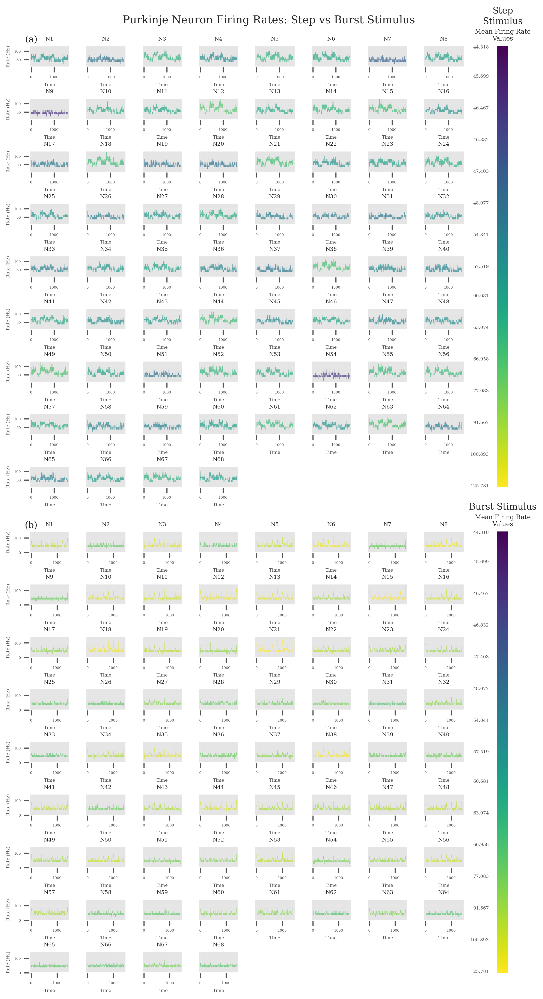

In [44]:
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec

# Create combined figure for Step and Burst neuron firing rates
fig = plt.figure(figsize=(8.27, 16), dpi=300)  # Increased height for two rows

# Create main GridSpec with 2 rows, 2 columns for the overall layout
gs_main = GridSpec(2, 2, figure=fig,
                   height_ratios=[1, 1],  # Equal height for both rows
                   width_ratios=[12, 0.3],  # Wide for neuron plots, narrow for heatmaps
                   left=0.05, right=0.95, top=0.95, bottom=0.05, 
                   hspace=0.1, wspace=0.15)

# ===== TOP ROW: Step Stimulus =====
# Create a sub-GridSpec within the top-left cell for step neuron plots
gs_step = GridSpecFromSubplotSpec(9, 8, gs_main[0, 0],
                                  hspace=1.5, wspace=0.4)

step_neuron_axes = []
for i in range(9 * 8):  # 72 axes total
    row = i // 8
    col = i % 8
    ax = fig.add_subplot(gs_step[row, col])
    step_neuron_axes.append(ax)

# Create heatmap axis for step stimulus (top-right cell)
step_heatmap_ax = fig.add_subplot(gs_main[0, 1])

# Call plot_neuron_firing_rate for step stimulus
fig_step, _, _ = plot_neuron_firing_rate(
    rates_per_neuronPC_stimulus_step,
    column_name='Mean_Firing_Rate',
    title='',  # We'll add our own title
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_step,
    fig=fig,
    neuron_axes=step_neuron_axes,
    heatmap_ax=step_heatmap_ax
)

# Add title for step section
step_heatmap_ax.text(0.5, 1.05, 'Step\nStimulus', 
                     transform=step_heatmap_ax.transAxes,
                     fontsize=10, ha='center')

# ===== BOTTOM ROW: Burst Stimulus =====
# Create a sub-GridSpec within the bottom-left cell for burst neuron plots
gs_burst = GridSpecFromSubplotSpec(9, 8, gs_main[1, 0],
                                   hspace=1.5, wspace=0.4)

burst_neuron_axes = []
for i in range(9 * 8):  # 72 axes total
    row = i // 8
    col = i % 8
    ax = fig.add_subplot(gs_burst[row, col])
    burst_neuron_axes.append(ax)

# Create heatmap axis for burst stimulus (bottom-right cell)
burst_heatmap_ax = fig.add_subplot(gs_main[1, 1])

# Call plot_neuron_firing_rate for burst stimulus
fig_burst, _, _ = plot_neuron_firing_rate(
    rates_per_neuronPC_burst,
    column_name='Mean_Firing_Rate',
    title='',  # We'll add our own title
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    cell_features_df=foof_features_burst,
    fig=fig,
    neuron_axes=burst_neuron_axes,
    heatmap_ax=burst_heatmap_ax
)

# Add title for burst section
burst_heatmap_ax.text(0.5, 1.05, 'Burst Stimulus', 
                      transform=burst_heatmap_ax.transAxes,
                      fontsize=10, ha='center')

# Add overall title
fig.suptitle('Purkinje Neuron Firing Rates: Step vs Burst Stimulus', 
             fontsize=12, y=0.98)

step_neuron_axes[0].text(0.2, 1.08, '(a)',
                     fontsize=10, ha='right', transform=step_neuron_axes[0].transAxes, va='bottom')
burst_neuron_axes[0].text(0.2, 1.08, '(b)',
                      fontsize=10, ha='right', transform=burst_neuron_axes[0].transAxes, va='bottom')
plt.show()

In [45]:
ica_features_pc_burst, ica_burst, mixing_matrix_burst = perform_ica(rates_per_neuronPC_burst.T, n_components=2, try_components=False)

ICA converged successfully
ICA features shape: (1421, 2)


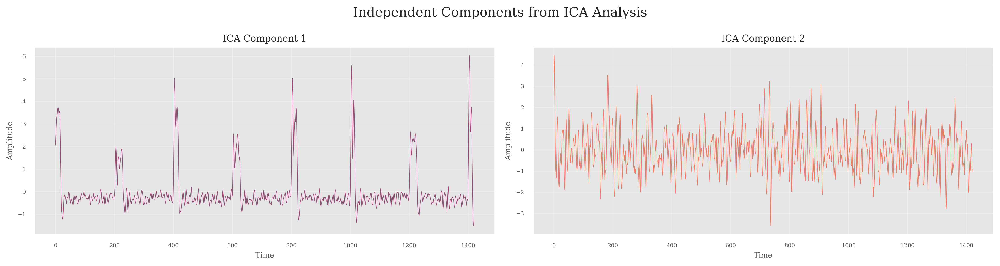

In [46]:
plot_ICA_components(ica_features_pc_burst, n_components=ica_features_pc_burst.shape[1])

In [47]:
# Create DataFrame from ICA features
ica_features_burst_df = pd.DataFrame(ica_features_pc_burst, columns=[f'ICA_Component_{i+1}' for i in range(ica_features_pc_burst.shape[1])])

ica_features_burst_df.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_features_burst.csv', index=False)


Shape of mixing matrix: (68, 2)
Using 2D scatter plot


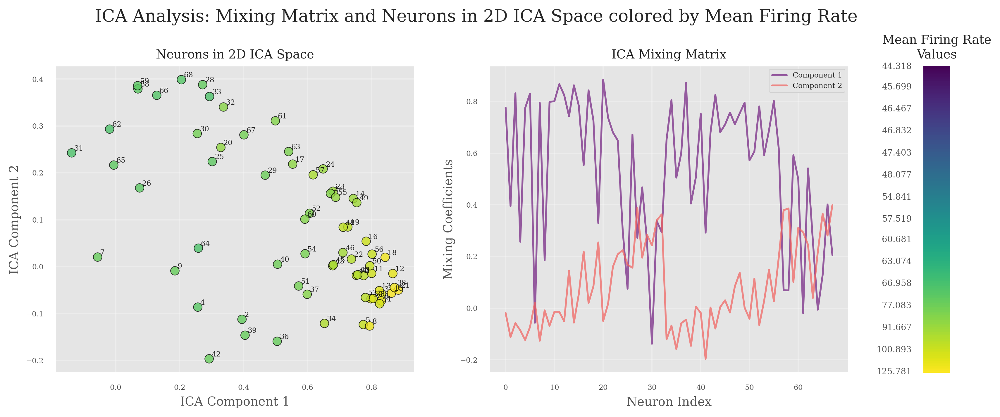

In [48]:
plot_mixing_matrix(
    mixing_matrix=mixing_matrix_burst, 
    n_components=2,
    cell_features_df=foof_features_burst,
    column_name='Mean_Firing_Rate',
    colors_raw=mean_fr_scheme['colors_raw'],
    labels_data=mean_fr_scheme['labels_data'],
    labels_display=mean_fr_scheme['labels_display'],
    label_colors=mean_fr_scheme['label_colors'],
    add_annotations=True
)

In [75]:
def plot_ica_projections_multi_panel(mixing_matrices, feature_dfs_list, color_by='mean_rate', 
                                    palette=None, titles=None, heatmap_labels_data=None, 
                                    heatmap_labels_display=None, heatmap_colors=None, 
                                    add_annotations=True, cluster_labels=None, use_clusters=False,
                                    axes=None, heatmap_ax=None, fig=None):
    """
    Create a multi-panel figure with ICA projections colored by different parameters
    
    Parameters:
    - mixing_matrices: List of 3 mixing matrices from ICA (one per condition)
    - feature_dfs_list: List of 3 DataFrames with features for coloring (or None when using clusters)
    - color_by: Feature to color by (when not using clusters)
    - palette: Color palette dictionary
    - titles: List of subplot titles
    - heatmap_labels_data: Data for colorbar heatmap
    - heatmap_labels_display: Labels for colorbar heatmap
    - heatmap_colors: Colors for colorbar heatmap
    - add_annotations: Whether to add neuron ID annotations
    - cluster_labels: List of 3 cluster assignment vectors (one per condition) when use_clusters=True
    - use_clusters: Flag to use cluster coloring instead of feature coloring
    - axes: List of 3 matplotlib axes to plot on (optional, will create new figure if None)
    - heatmap_ax: Matplotlib axis for heatmap colorbar (optional)
    - fig: Figure object (optional, will create new figure if None and axes is None)
    """
    
    if use_clusters and cluster_labels is None:
        raise ValueError("cluster_labels must be provided when use_clusters=True")
    
    if use_clusters and len(cluster_labels) != 3:
        raise ValueError("cluster_labels must contain exactly 3 cluster assignment vectors")

    # Create figure and axes if not provided
    if axes is None:
        if use_clusters:
            # No heatmap needed for clusters
            if fig is None:
                fig = plt.figure(figsize=(10, 8.27), dpi=300)
            gs = GridSpec(1, 3, figure=fig,
                          width_ratios=[1, 1, 1],
                          left=0.1, right=0.95, top=0.85, bottom=0.15, 
                          wspace=0.3)
            has_heatmap = False
        else:
            if fig is None:
                fig = plt.figure(figsize=(10, 8.27), dpi=300)
            gs = GridSpec(1, 4, figure=fig,
                          width_ratios=[2, 2, 2, 0.15],
                          left=0.01, right=0.95, top=0.92, bottom=0.15, 
                          wspace=0.35)
            has_heatmap = True
        
        axes_scatter = []
        for i in range(3):
            ax = fig.add_subplot(gs[0, i])
            axes_scatter.append(ax)
        
        if has_heatmap and heatmap_ax is None:
            ax_heatmap = fig.add_subplot(gs[0, 3])
        else:
            ax_heatmap = heatmap_ax
            
        # Set main title if we created the figure
        if use_clusters:
            main_title = "ICA Projections: Neurons Colored by Cluster Assignment"
        else:
            main_title = f"ICA Projections: Neurons Colored by {color_by.replace('_', ' ').title()}"
        
        if fig is not None:
            fig.suptitle(main_title)
    else:
        # Use provided axes
        if len(axes) != 3:
            raise ValueError("axes must contain exactly 3 matplotlib axes")
        axes_scatter = axes
        ax_heatmap = heatmap_ax
        has_heatmap = (heatmap_ax is not None and not use_clusters)
    
    if titles is None:
        titles = ['Baseline', 'Step', 'Burst']
    
    for i, (ax, mixing_matrix, title) in enumerate(zip(axes_scatter, mixing_matrices, titles)):
        
        if use_clusters:
            # Color by clusters - get the cluster vector for this condition
            clusters = cluster_labels[i]
            unique_clusters = np.unique(clusters)
            
            if len(unique_clusters) == 2:
                cluster_colors = ['blue', 'red']
            else:
                cluster_colors = plt.cm.get_cmap('tab10', len(unique_clusters))
            
            for cluster in unique_clusters:
                cluster_indices = np.where(clusters == cluster)[0]
                color = cluster_colors[cluster] if len(unique_clusters) == 2 else cluster_colors(cluster)
                ax.scatter(mixing_matrix[cluster_indices, 0], mixing_matrix[cluster_indices, 1], 
                          alpha=0.8, s=30, label=f'Cluster {cluster}', color=color,
                          edgecolors='black', linewidth=0.5)
            
            if i == 0:  # Add legend only to first plot
                ax.legend(framealpha=0.8)
                
        else:
            # Color by feature values
            feature_df = feature_dfs_list[i]
            if color_by in feature_df.columns and palette is not None:
                neuron_colors = []
                for idx in range(len(feature_df)):
                    feature_value = feature_df.iloc[idx][color_by]
                    # Find the closest color in our color scheme
                    value_idx = np.argmin(np.abs(np.array(list(palette.keys())) - feature_value))
                    closest_value = list(palette.keys())[value_idx]
                    neuron_colors.append(palette[closest_value])
                
                scatter = ax.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                                   c=neuron_colors, alpha=0.8, s=15, 
                                   edgecolors='black', linewidth=0.5)
            else:
                # Fallback to single color
                ax.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                          alpha=0.8, s=15, color='blue',
                          edgecolors='black', linewidth=0.5)
        
        if add_annotations:
            for neuron_idx in range(len(mixing_matrix)):
                # Use cell_id from appropriate feature DataFrame
                if not use_clusters and feature_dfs_list is not None:
                    # Use the corresponding feature DataFrame for this condition
                    feature_df = feature_dfs_list[i]
                    if 'cell_id' in feature_df.columns and neuron_idx < len(feature_df):
                        annotation_text = str(int(feature_df.iloc[neuron_idx]['cell_id']))
                    else:
                        annotation_text = str(neuron_idx)
                else:
                    # For cluster mode or when no feature DataFrames available
                    annotation_text = str(neuron_idx)
                    
                ax.annotate(annotation_text, 
                           (mixing_matrix[neuron_idx, 0], mixing_matrix[neuron_idx, 1]), 
                           alpha=0.8, color='black',
                           textcoords='offset points', xytext=(2,2),
                           fontsize=6)
        
        ax.set_title(f'{title}')
        ax.set_xlabel('ICA Component 1')
        ax.set_ylabel('ICA Component 2')
        ax.grid(True, alpha=0.3)
    
    if has_heatmap and heatmap_labels_data is not None and heatmap_colors is not None:
        sns.heatmap(data=heatmap_labels_data, ax=ax_heatmap, 
                   cmap=mcolors.ListedColormap(heatmap_colors), 
                   cbar=False, yticklabels=heatmap_labels_display, 
                   xticklabels=False)
        ax_heatmap.set_title(f"{color_by.replace('_', ' ').title()}\nValues")
        ax_heatmap.tick_params(axis='y', labelsize=5)
    
    # Only show the figure if we created it
    if axes is None:
        plt.show()
    
    # Return the axes for further customization if needed
    return axes_scatter, ax_heatmap if has_heatmap else None

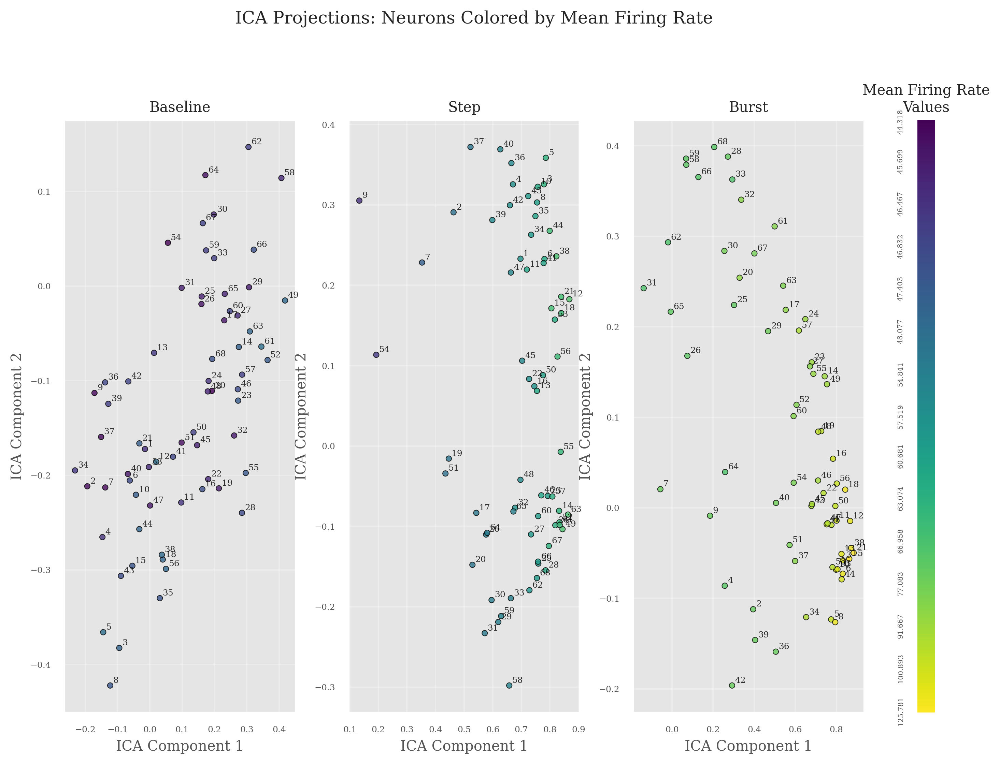

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Mean Firing Rate\nValues'}>)

In [50]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Firing_Rate',
    palette=mean_fr_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=mean_fr_scheme['labels_data'],
    heatmap_labels_display=mean_fr_scheme['labels_display'],
    heatmap_colors=mean_fr_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

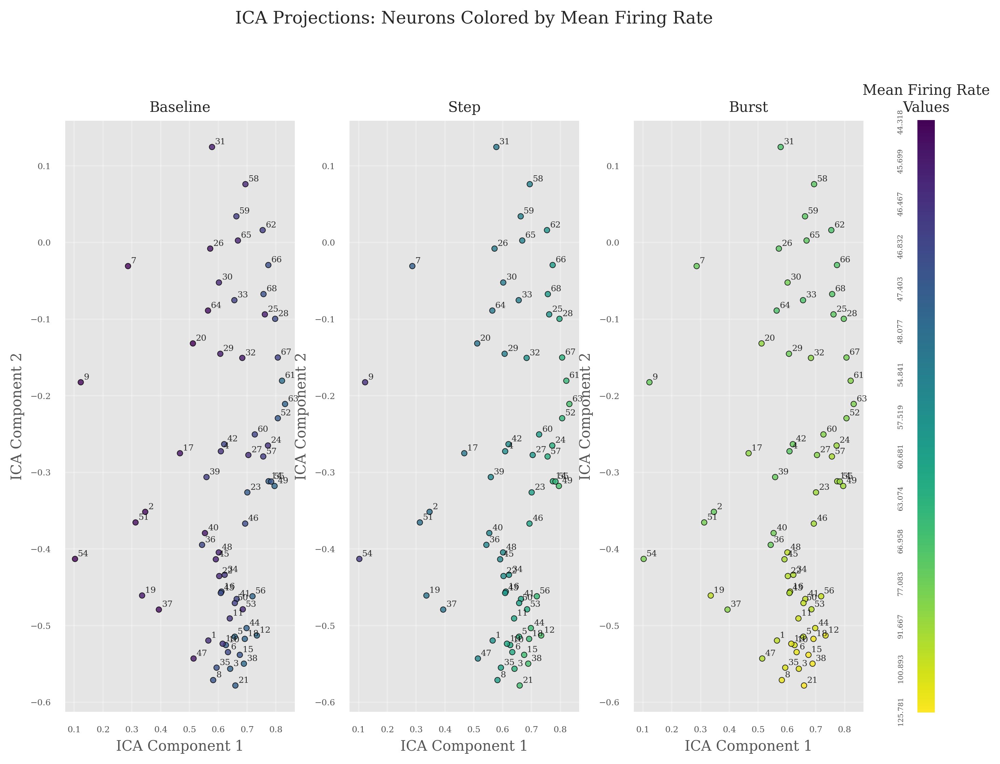

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Mean Firing Rate\nValues'}>)

In [51]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Firing_Rate',
    palette=mean_fr_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=mean_fr_scheme['labels_data'],
    heatmap_labels_display=mean_fr_scheme['labels_display'],
    heatmap_colors=mean_fr_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

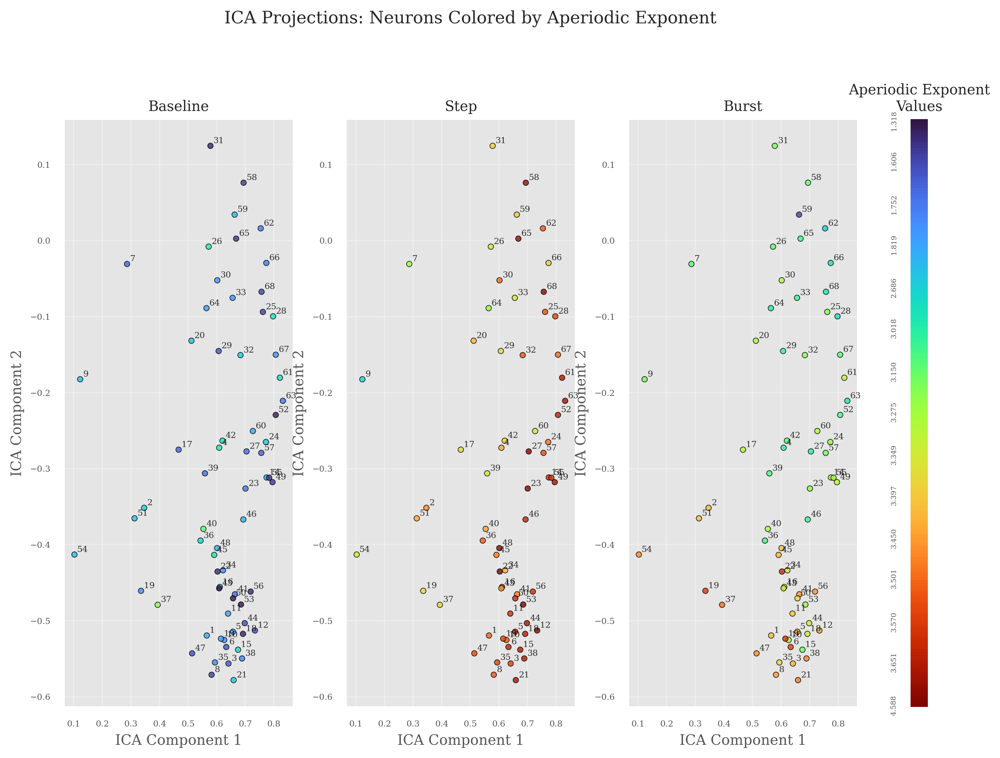

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Aperiodic Exponent\nValues'}>)

In [52]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Aperiodic_Exponent',
    palette=aperiodic_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=aperiodic_scheme['labels_data'],
    heatmap_labels_display=aperiodic_scheme['labels_display'],
    heatmap_colors=aperiodic_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

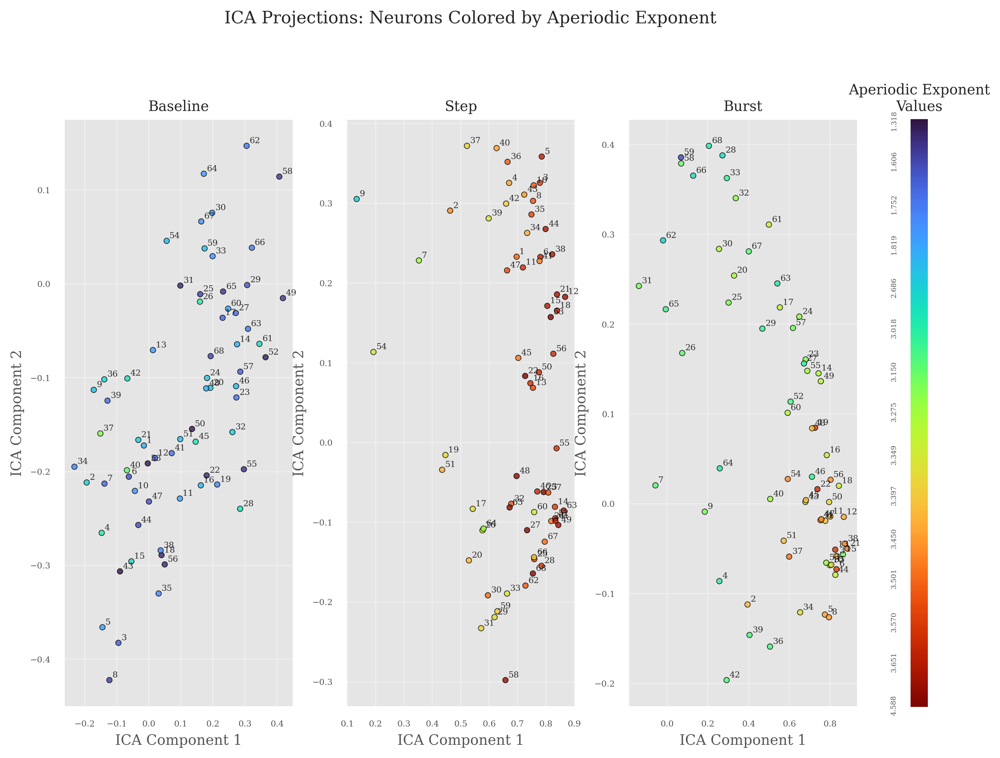

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Aperiodic Exponent\nValues'}>)

In [53]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Aperiodic_Exponent',
    palette=aperiodic_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=aperiodic_scheme['labels_data'],
    heatmap_labels_display=aperiodic_scheme['labels_display'],
    heatmap_colors=aperiodic_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

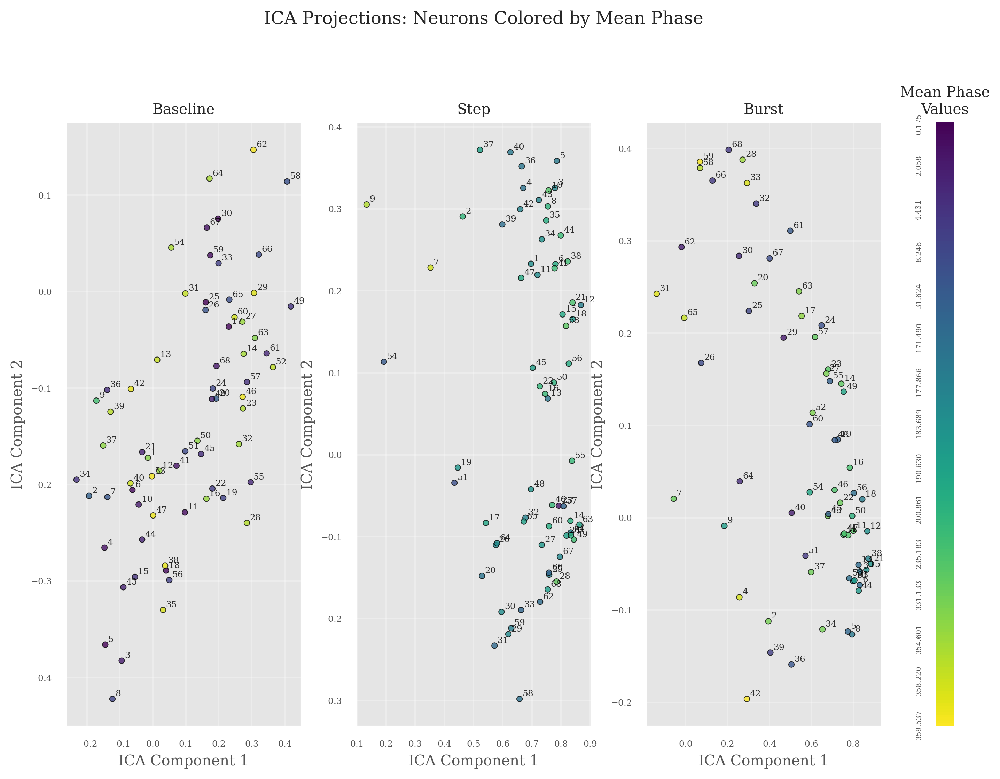

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Mean Phase\nValues'}>)

In [54]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Phase',
    palette=phase_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=phase_scheme['labels_data'],
    heatmap_labels_display=phase_scheme['labels_display'],
    heatmap_colors=phase_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

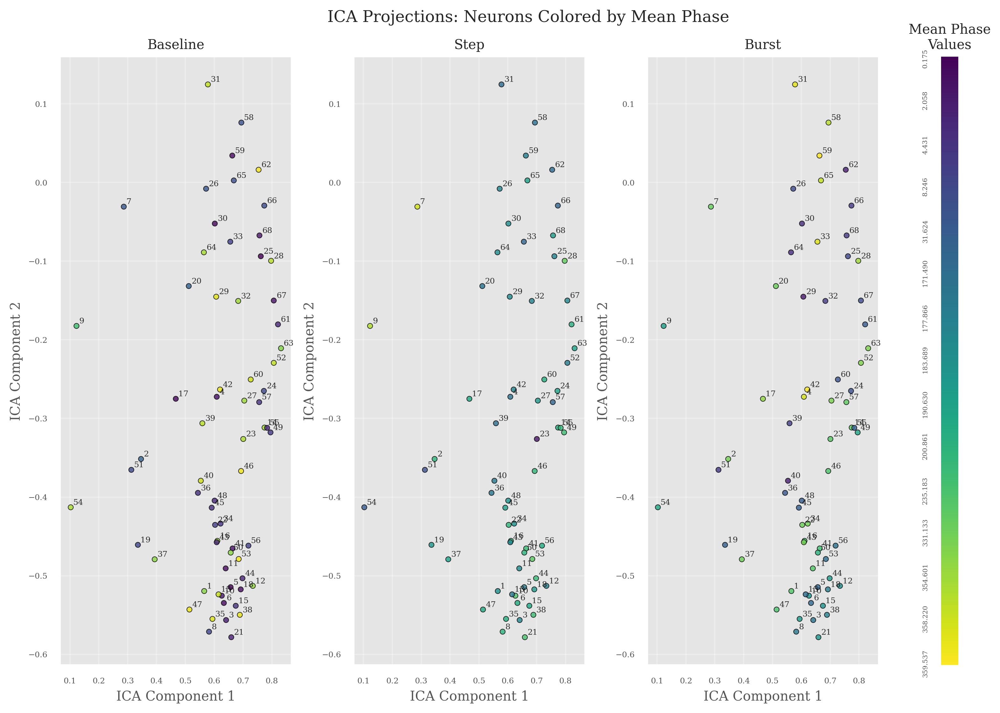

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Mean Phase\nValues'}>)

In [76]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Phase',
    palette=phase_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=phase_scheme['labels_data'],
    heatmap_labels_display=phase_scheme['labels_display'],
    heatmap_colors=phase_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

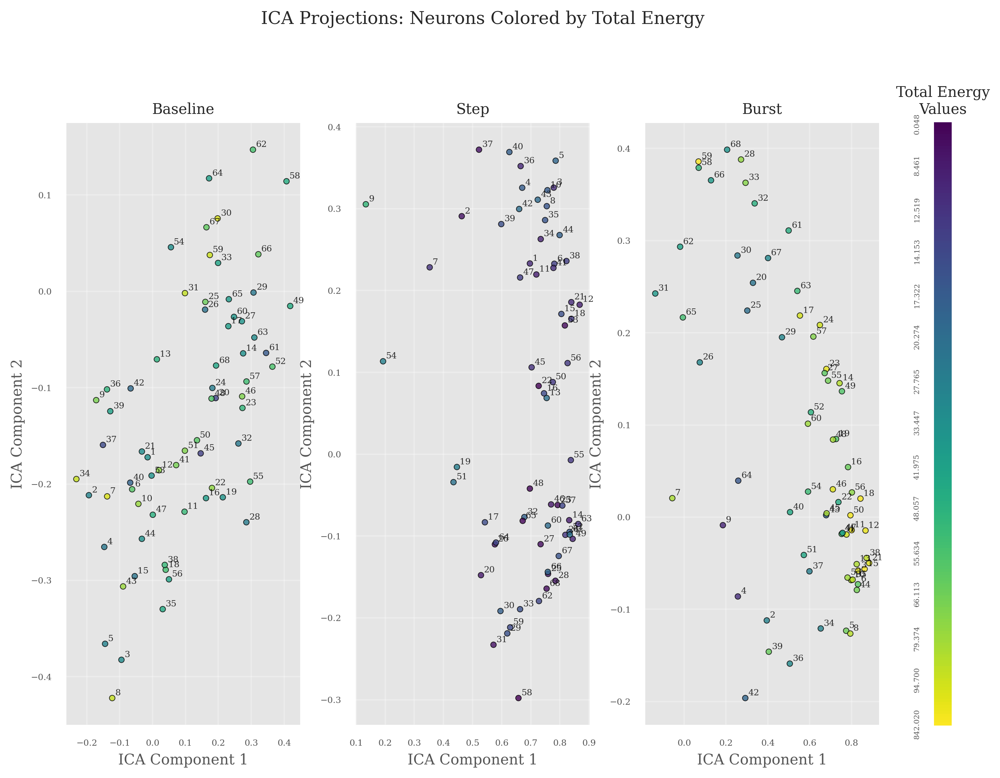

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Total Energy\nValues'}>)

In [56]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Total_Energy',
    palette=energy_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=energy_scheme['labels_data'],
    heatmap_labels_display=energy_scheme['labels_display'],
    heatmap_colors=energy_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

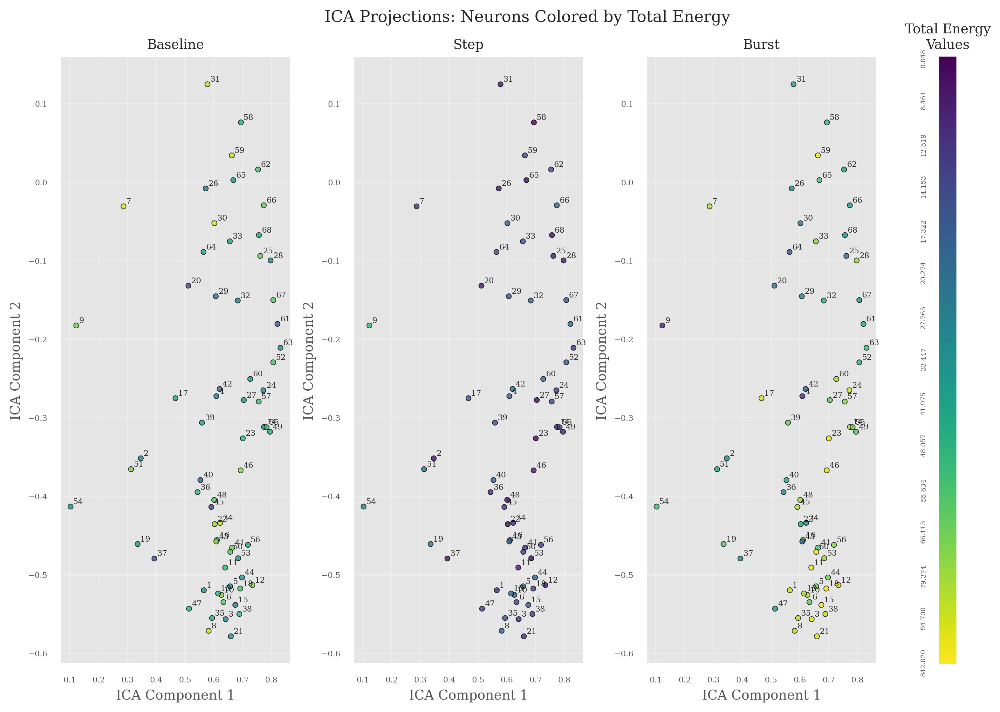

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Total Energy\nValues'}>)

In [77]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Total_Energy',
    palette=energy_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=energy_scheme['labels_data'],
    heatmap_labels_display=energy_scheme['labels_display'],
    heatmap_colors=energy_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

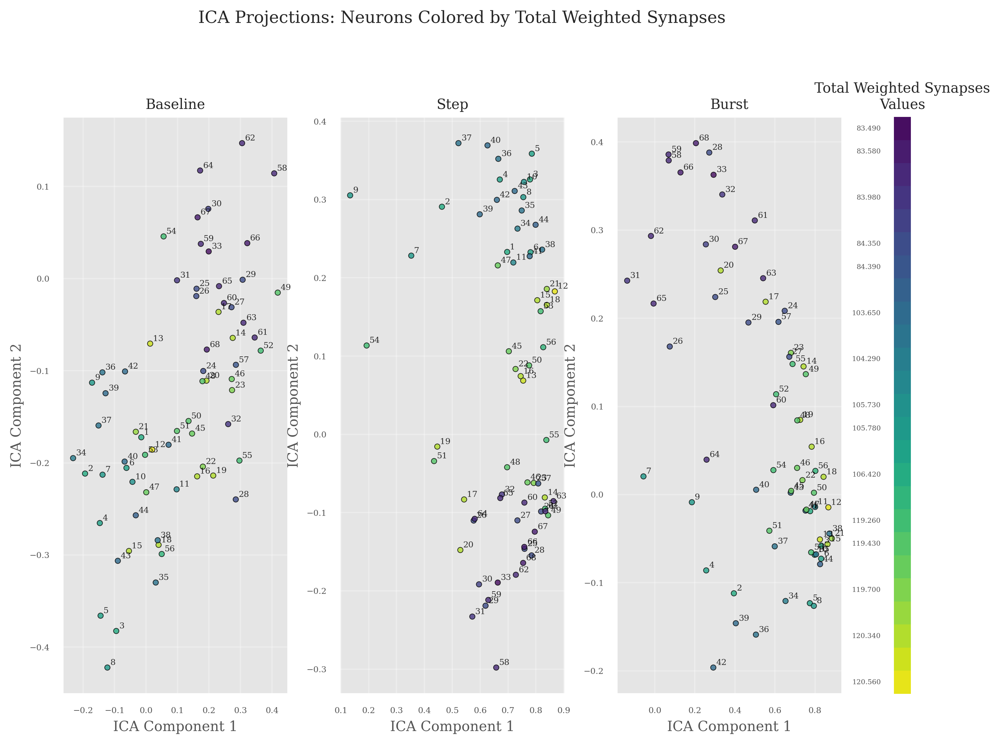

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 <Axes: title={'center': 'Total Weighted Synapses\nValues'}>)

In [58]:
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Total_Weighted_Synapses',
    palette=synapse_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=synapse_scheme['labels_data'],
    heatmap_labels_display=synapse_scheme['labels_display'],
    heatmap_colors=synapse_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False
)

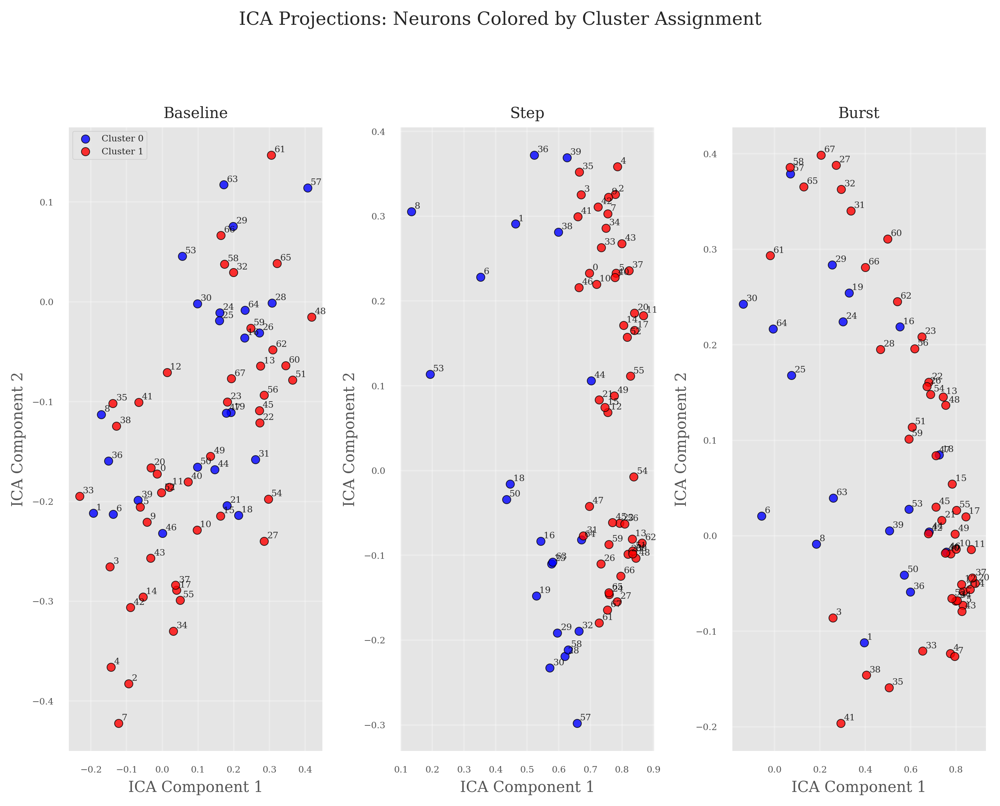

([<Axes: title={'center': 'Baseline'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Step'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 None)

In [59]:
# coloring by clusters assignments
clusters_baseline = corr_results_baseline['Cluster'].values
clusters_step = corr_results_step['Cluster'].values
clusters_burst = corr_results_burst['Cluster'].values

plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix_baseline, mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=None,
    titles=['Baseline', 'Step', 'Burst'],
    cluster_labels=[clusters_baseline, clusters_step, clusters_burst],
    add_annotations=True,
    use_clusters=True
)




In [60]:
# Entire stimulus ICA projections
entire_ica_projections = pd.DataFrame({
    'cell_id': foof_features_stimulus['cell_id'] if 'cell_id' in foof_features_stimulus.columns else range(len(mixing_matrix)),
    'ICA_Component_1': mixing_matrix[:, 0],
    'ICA_Component_2': mixing_matrix[:, 1],
    'condition': 'entire_stimulus'
})

entire_ica_projections.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_projections_entire_stimulus.csv', index=False)

In [61]:
# Baseline ICA projections
baseline_ica_projections = pd.DataFrame({
    'cell_id': foof_features_baseline['cell_id'] if 'cell_id' in foof_features_baseline.columns else range(len(mixing_matrix_baseline)),
    'ICA_Component_1': mixing_matrix_baseline[:, 0],
    'ICA_Component_2': mixing_matrix_baseline[:, 1],
    'condition': 'baseline'
})

# Step stimulus ICA projections
step_ica_projections = pd.DataFrame({
    'cell_id': foof_features_step['cell_id'] if 'cell_id' in foof_features_step.columns else range(len(mixing_matrix_step)),
    'ICA_Component_1': mixing_matrix_step[:, 0],
    'ICA_Component_2': mixing_matrix_step[:, 1],
    'condition': 'step'
})

# Burst stimulus ICA projections
burst_ica_projections = pd.DataFrame({
    'cell_id': foof_features_burst['cell_id'] if 'cell_id' in foof_features_burst.columns else range(len(mixing_matrix_burst)),
    'ICA_Component_1': mixing_matrix_burst[:, 0],
    'ICA_Component_2': mixing_matrix_burst[:, 1],
    'condition': 'burst'
})

# Save to CSV files
# baseline_ica_projections.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_projections_baseline.csv', index=False)
# step_ica_projections.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_projections_step.csv', index=False)
# burst_ica_projections.to_csv('/home/nix/Uni/3Year/Thesis/testStefania/multiLevels/ica_projections_burst.csv', index=False)

# Analysis of the components

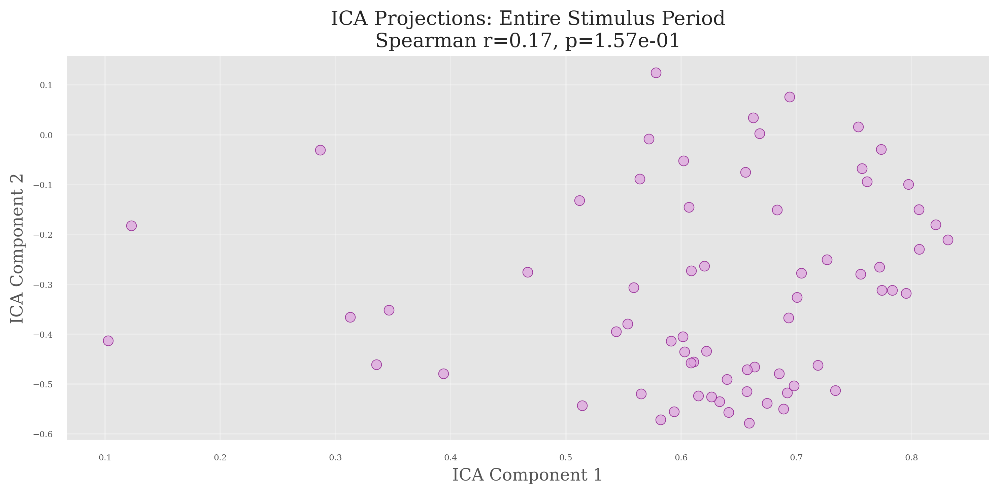

In [62]:
fig, ax = plt.subplots(1, 1, figsize=(10, 5), dpi=300)

x = mixing_matrix[:, 0]
y = mixing_matrix[:, 1]
r, p = stats.spearmanr(x, y)

ax.scatter(x, y, alpha=0.7, s=50, color='plum', edgecolors='purple', linewidth=0.5)
ax.set_title(f'ICA Projections: Entire Stimulus Period\nSpearman r={r:.2f}, p={p:.2e}', fontsize=14)
ax.set_xlabel('ICA Component 1', fontsize=12)
ax.set_ylabel('ICA Component 2', fontsize=12)
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


In [63]:
def plot_ICA_components(ica_features, n_components=2, fig=None, axes=None):
    """
    Plot the independent components obtained from ICA.
    
    Parameters:
    - ica_features: ICA features array
    - n_components: Number of components to plot
    - fig: Optional figure object for embedding
    - axes: Optional axes array for embedding
    """
    if type(ica_features) is pd.DataFrame:
        ica_features = ica_features.values
    if n_components <= 5:
        rows, cols = 1, n_components
        figsize = (15, 4)
    elif n_components <= 10:
        rows, cols = 2, (n_components + 1) // 2
        figsize = (15, 8)
    else:
        rows = (n_components + 4) // 5
        cols = 5
        figsize = (15, rows * 3)
    
    # Check if we need to create new figure and axes
    create_new_fig = fig is None or axes is None
    
    if create_new_fig:
        fig, axes = plt.subplots(rows, cols, figsize=figsize, dpi=300)
        
        if rows == 1:
            axes = axes if n_components > 1 else [axes]
        else:
            axes = axes.flatten()
    
    colors_comp = sns.color_palette('rocket', n_colors=n_components)
    
    for i in range(n_components):
        axes[i].plot(ica_features[:, i], color=colors_comp[i], alpha=0.8, linewidth=0.5)
        axes[i].set_title(f'ICA Component {i+1}')
        axes[i].set_xlabel('Time (ms)')
        axes[i].set_ylabel('Amplitude (Hz)')
        axes[i].grid(True, alpha=0.3)
        axes[i].tick_params(axis='both', which='major')
    
    # Turn off unused axes
    for i in range(n_components, rows * cols):
        axes[i].axis('off')
    
    # Only add title and show if we created a new figure
    if create_new_fig:
        plt.suptitle('Independent Components from ICA Analysis')
        plt.tight_layout()
        plt.show()

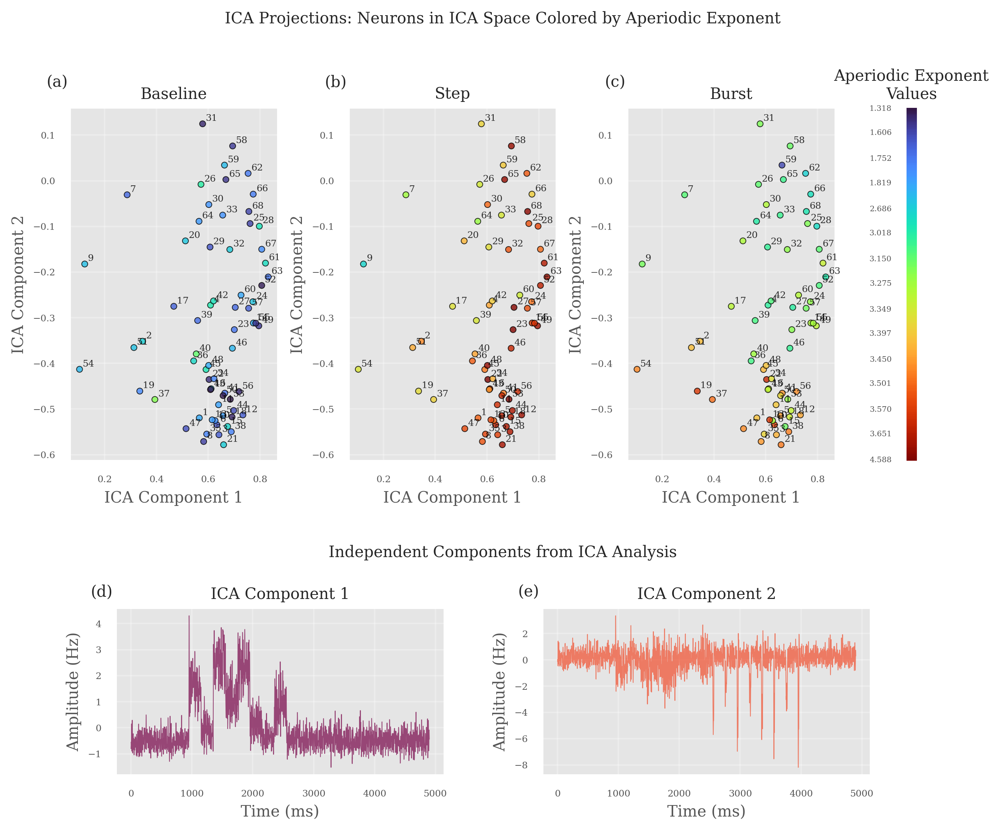

In [64]:
# Create combined figure
fig = plt.figure(figsize=(8.27, 10), dpi=300)
gs = GridSpec(2, 4, figure=fig, 
              height_ratios=[1, 0.8],
              width_ratios=[2, 2, 2, 0.1], 
              left=0.03, right=0.95, top=0.9, bottom=0.3,
              hspace=0.1, wspace=0.45)

# ==================================================
# Top row: ICA Projections colored by Aperiodic Exponent
ax1_top = fig.add_subplot(gs[0, 0])
ax2_top = fig.add_subplot(gs[0, 1])
ax3_top = fig.add_subplot(gs[0, 2])
ax_heatmap_top = fig.add_subplot(gs[0, 3])

# Create axes list for the ICA projections function
ica_axes = [ax1_top, ax2_top, ax3_top]

# Call the ICA projections function with existing axes
plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Aperiodic_Exponent',
    palette=aperiodic_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=aperiodic_scheme['labels_data'],
    heatmap_labels_display=aperiodic_scheme['labels_display'],
    heatmap_colors=aperiodic_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False,
    axes=ica_axes,
    heatmap_ax=ax_heatmap_top,
    fig=fig
)

# Add panel labels for top row
ax1_top.text(-0.01, 1.05, '(a)', transform=ax1_top.transAxes, va='bottom', ha='right')
ax2_top.text(-0.01, 1.05, '(b)', transform=ax2_top.transAxes, va='bottom', ha='right')
ax3_top.text(-0.01, 1.05, '(c)', transform=ax3_top.transAxes, va='bottom', ha='right')

# ==================================================
# Bottom row: ICA Components
gs_bottom = GridSpec(1, 2, figure=fig, 
                     left=0.08, right=0.9,  # Only use the space of first 3 columns
                     top=0.45, bottom=0.3,
                     wspace=0.3, hspace=0.8)

ax_comp1 = fig.add_subplot(gs_bottom[0, 0])  # First component
ax_comp2 = fig.add_subplot(gs_bottom[0, 1])  # Second component

# Create axes list for the ICA components function
comp_axes = [ax_comp1, ax_comp2]

# Call the ICA components function with existing axes
plot_ICA_components(ica_features_pc, n_components=2, fig=fig, axes=comp_axes)

# Add panel labels for bottom row
ax_comp1.text(-0.01, 1.05, '(d)', transform=ax_comp1.transAxes, va='bottom', ha='right')
ax_comp2.text(-0.01, 1.05, '(e)', transform=ax_comp2.transAxes, va='bottom', ha='right')

# Add overall titles for each section
fig.text(0.5, 0.98, "ICA Projections: Neurons in ICA Space Colored by Aperiodic Exponent", 
         ha='center', va='center')
fig.text(0.5, 0.5, "Independent Components from ICA Analysis", 
         ha='center', va='center')

plt.show()

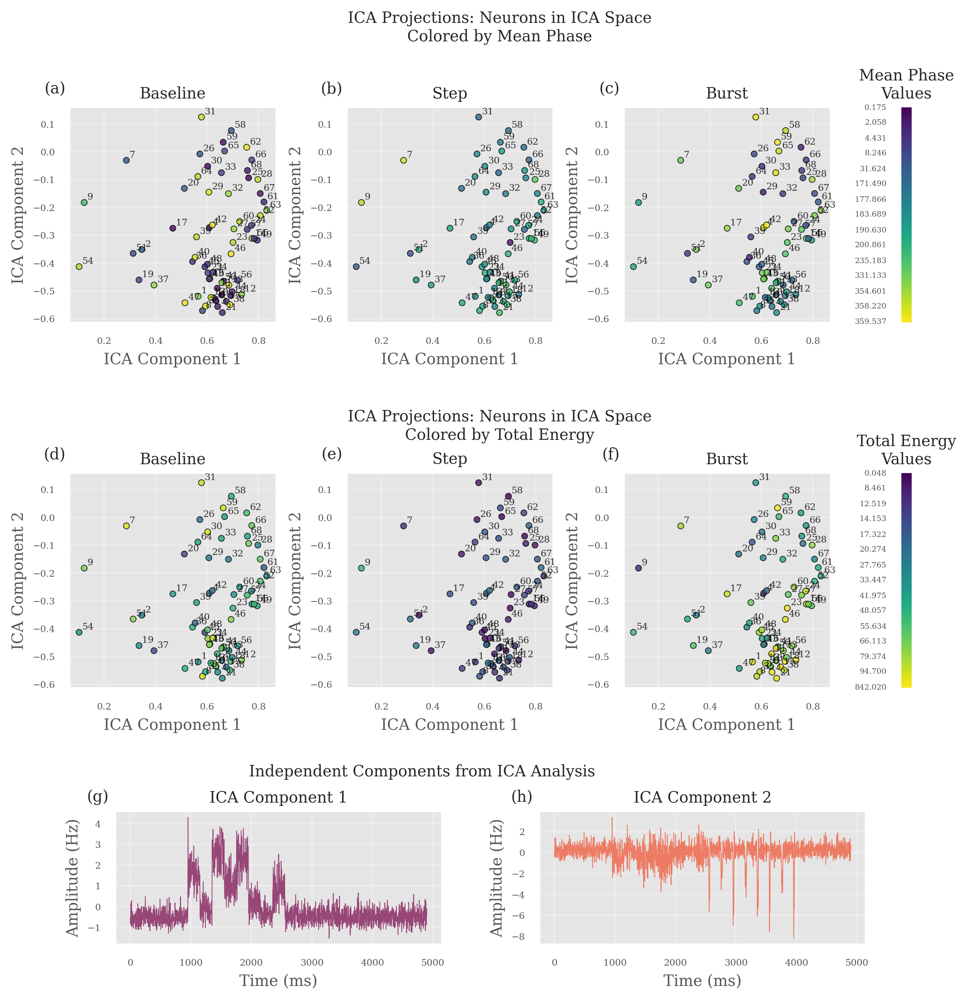

In [65]:
# Create combined figure with all features and components
fig = plt.figure(figsize=(8.27, 12), dpi=300)
gs = GridSpec(3, 4, figure=fig, 
              height_ratios=[1, 1, 0.8],
              width_ratios=[2, 2, 2, 0.1], 
              left=0.03, right=0.95, top=0.88, bottom=0.2,
              hspace=0.75, wspace=0.45)

# ==================================================
# First row: ICA Projections colored by Mean Phase
ax1_phase = fig.add_subplot(gs[0, 0])
ax2_phase = fig.add_subplot(gs[0, 1])
ax3_phase = fig.add_subplot(gs[0, 2])
ax_heatmap_phase = fig.add_subplot(gs[0, 3])

phase_axes = [ax1_phase, ax2_phase, ax3_phase]

plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Phase',
    palette=phase_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=phase_scheme['labels_data'],
    heatmap_labels_display=phase_scheme['labels_display'],
    heatmap_colors=phase_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False,
    axes=phase_axes,
    heatmap_ax=ax_heatmap_phase,
    fig=fig
)

# Add panel labels for first row
ax1_phase.text(-0.02, 1.05, '(a)', transform=ax1_phase.transAxes, va='bottom', ha='right')
ax2_phase.text(-0.02, 1.05, '(b)', transform=ax2_phase.transAxes, va='bottom', ha='right')
ax3_phase.text(-0.02, 1.05, '(c)', transform=ax3_phase.transAxes, va='bottom', ha='right')

# ==================================================
# Second row: ICA Projections colored by Total Energy
ax1_energy = fig.add_subplot(gs[1, 0])
ax2_energy = fig.add_subplot(gs[1, 1])
ax3_energy = fig.add_subplot(gs[1, 2])
ax_heatmap_energy = fig.add_subplot(gs[1, 3])

energy_axes = [ax1_energy, ax2_energy, ax3_energy]

plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Total_Energy',
    palette=energy_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=energy_scheme['labels_data'],
    heatmap_labels_display=energy_scheme['labels_display'],
    heatmap_colors=energy_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False,
    axes=energy_axes,
    heatmap_ax=ax_heatmap_energy,
    fig=fig
)

# Add panel labels for second row
ax1_energy.text(-0.02, 1.05, '(d)', transform=ax1_energy.transAxes, va='bottom', ha='right')
ax2_energy.text(-0.02, 1.05, '(e)', transform=ax2_energy.transAxes, va='bottom', ha='right')
ax3_energy.text(-0.02, 1.05, '(f)', transform=ax3_energy.transAxes, va='bottom', ha='right')

# ==================================================
# Third row: ICA Components
gs_bottom = GridSpec(1, 2, figure=fig, 
                     left=0.08, right=0.9, 
                     top=0.35, bottom=0.25,
                     wspace=0.3)

ax_comp1 = fig.add_subplot(gs_bottom[0, 0])  # First component
ax_comp2 = fig.add_subplot(gs_bottom[0, 1])  # Second component

# Create axes list for the ICA components function
comp_axes = [ax_comp1, ax_comp2]

# Call the ICA components function with existing axes
plot_ICA_components(ica_features_pc, n_components=2, fig=fig, axes=comp_axes)

# Add panel labels for bottom row
ax_comp1.text(-0.02, 1.05, '(g)', transform=ax_comp1.transAxes, va='bottom', ha='right')
ax_comp2.text(-0.02, 1.05, '(h)', transform=ax_comp2.transAxes, va='bottom', ha='right')

# Add section titles
fig.text(0.5, 0.94, "ICA Projections: Neurons in ICA Space\nColored by Mean Phase", 
         ha='center', va='center')
fig.text(0.5, 0.64, "ICA Projections: Neurons in ICA Space\nColored by Total Energy", 
         ha='center', va='center')
fig.text(0.415, 0.38, "Independent Components from ICA Analysis", 
         ha='center', va='center')

plt.show()

In [66]:
def plot_ica_projections_multi_panel_separate(mixing_matrices, feature_dfs_list, color_by='mean_rate', 
                                             palettes=None, titles=None, 
                                             heatmap_labels_data_list=None, 
                                             heatmap_labels_display_list=None, 
                                             heatmap_colors_list=None, 
                                             add_annotations=True, cluster_labels=None, use_clusters=False,
                                             axes=None, heatmap_axes=None, fig=None):
    """
    Create a multi-panel figure with ICA projections colored by different parameters,
    with separate color schemes and heatmaps for each condition.
    
    Parameters:
    - mixing_matrices: List of mixing matrices from ICA (one per condition)
    - feature_dfs_list: List of DataFrames with features for coloring (or None when using clusters)
    - color_by: Feature to color by (when not using clusters)
    - palettes: List of color palette dictionaries (one per condition)
    - titles: List of subplot titles
    - heatmap_labels_data_list: List of data for colorbar heatmaps (one per condition)
    - heatmap_labels_display_list: List of labels for colorbar heatmaps (one per condition)
    - heatmap_colors_list: List of colors for colorbar heatmaps (one per condition)
    - add_annotations: Whether to add neuron ID annotations
    - cluster_labels: List of cluster assignment vectors (one per condition) when use_clusters=True
    - use_clusters: Flag to use cluster coloring instead of feature coloring
    - axes: List of matplotlib axes to plot on (optional, will create new figure if None)
    - heatmap_axes: List of matplotlib axes for heatmap colorbars (optional)
    - fig: Figure object (optional, will create new figure if None and axes is None)
    
    Returns:
    - axes_scatter: List of scatter plot axes
    - heatmap_axes: List of heatmap axes (if created or provided)
    """
    
    n_conditions = len(mixing_matrices)
    
    if use_clusters and cluster_labels is None:
        raise ValueError("cluster_labels must be provided when use_clusters=True")
    
    if use_clusters and len(cluster_labels) != n_conditions:
        raise ValueError(f"cluster_labels must contain exactly {n_conditions} cluster assignment vectors")

    # Validate input lists
    if not use_clusters:
        if palettes is not None and len(palettes) != n_conditions:
            raise ValueError(f"palettes must contain exactly {n_conditions} color schemes")
        if heatmap_labels_data_list is not None and len(heatmap_labels_data_list) != n_conditions:
            raise ValueError(f"heatmap_labels_data_list must contain exactly {n_conditions} items")
        if heatmap_labels_display_list is not None and len(heatmap_labels_display_list) != n_conditions:
            raise ValueError(f"heatmap_labels_display_list must contain exactly {n_conditions} items")
        if heatmap_colors_list is not None and len(heatmap_colors_list) != n_conditions:
            raise ValueError(f"heatmap_colors_list must contain exactly {n_conditions} items")

    # Create figure and axes if not provided
    if axes is None:
        if use_clusters:
            # No heatmap needed for clusters
            if fig is None:
                fig = plt.figure(figsize=(5 * n_conditions, 5), dpi=300)
            gs = GridSpec(1, n_conditions, figure=fig,
                          width_ratios=[1] * n_conditions,
                          left=0.1, right=0.95, top=0.85, bottom=0.15, 
                          wspace=0.3)
            has_heatmaps = False
        else:
            if fig is None:
                fig = plt.figure(figsize=(4 * n_conditions + 2, 5), dpi=300)
            # Create grid with space for heatmaps
            width_ratios = []
            for i in range(n_conditions):
                width_ratios.extend([2, 0.15])  # scatter plot + heatmap for each condition
            
            gs = GridSpec(1, len(width_ratios), figure=fig,
                          width_ratios=width_ratios,
                          left=0.1, right=0.95, top=0.85, bottom=0.15, 
                          wspace=0.3)
            has_heatmaps = True
        
        axes_scatter = []
        heatmap_axes_created = []
        
        for i in range(n_conditions):
            if has_heatmaps:
                ax_scatter = fig.add_subplot(gs[0, i * 2])  # Every other column for scatter plots
                ax_heatmap = fig.add_subplot(gs[0, i * 2 + 1])  # Heatmap next to each scatter plot
                heatmap_axes_created.append(ax_heatmap)
            else:
                ax_scatter = fig.add_subplot(gs[0, i])
            axes_scatter.append(ax_scatter)
        
        if has_heatmaps:
            heatmap_axes = heatmap_axes_created
        else:
            heatmap_axes = None
            
        # Set main title if we created the figure
        if use_clusters:
            main_title = "ICA Projections: Neurons Colored by Cluster Assignment"
        else:
            main_title = f"ICA Projections: Neurons Colored by {color_by.replace('_', ' ').title()}"
        
        if fig is not None:
            fig.suptitle(main_title)
    else:
        # Use provided axes
        if len(axes) != n_conditions:
            raise ValueError(f"axes must contain exactly {n_conditions} matplotlib axes")
        axes_scatter = axes
        has_heatmaps = (heatmap_axes is not None and not use_clusters)
    
    if titles is None:
        titles = [f'Condition {i+1}' for i in range(n_conditions)]
    
    # Plot each condition
    for i, (ax, mixing_matrix, title) in enumerate(zip(axes_scatter, mixing_matrices, titles)):
        
        if use_clusters:
            # Color by clusters - get the cluster vector for this condition
            clusters = cluster_labels[i]
            unique_clusters = np.unique(clusters)
            
            if len(unique_clusters) == 2:
                cluster_colors = ['blue', 'red']
            else:
                cluster_colors = plt.cm.get_cmap('tab10', len(unique_clusters))
            
            for cluster in unique_clusters:
                cluster_indices = np.where(clusters == cluster)[0]
                color = cluster_colors[cluster] if len(unique_clusters) == 2 else cluster_colors(cluster)
                ax.scatter(mixing_matrix[cluster_indices, 0], mixing_matrix[cluster_indices, 1], 
                          alpha=0.8, s=30, label=f'Cluster {cluster}', color=color,
                          edgecolors='black', linewidth=0.5)
            
            if i == 0:  # Add legend only to first plot
                ax.legend(framealpha=0.8)
                
        else:
            # Color by feature values using condition-specific palette
            feature_df = feature_dfs_list[i]
            palette = palettes[i] if palettes is not None else None
            
            if color_by in feature_df.columns and palette is not None:
                neuron_colors = []
                for idx in range(len(feature_df)):
                    feature_value = feature_df.iloc[idx][color_by]
                    # Find the closest color in our color scheme
                    value_idx = np.argmin(np.abs(np.array(list(palette.keys())) - feature_value))
                    closest_value = list(palette.keys())[value_idx]
                    neuron_colors.append(palette[closest_value])
                
                scatter = ax.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                                   c=neuron_colors, alpha=0.8, s=15, 
                                   edgecolors='black', linewidth=0.5)
            else:
                # Fallback to single color
                ax.scatter(mixing_matrix[:, 0], mixing_matrix[:, 1], 
                          alpha=0.8, s=15, color='blue',
                          edgecolors='black', linewidth=0.5)
        
        if add_annotations:
            for neuron_idx in range(len(mixing_matrix)):
                # Use cell_id from appropriate feature DataFrame
                if not use_clusters and feature_dfs_list is not None:
                    # Use the corresponding feature DataFrame for this condition
                    feature_df = feature_dfs_list[i]
                    if 'cell_id' in feature_df.columns and neuron_idx < len(feature_df):
                        annotation_text = str(int(feature_df.iloc[neuron_idx]['cell_id']))
                    else:
                        annotation_text = str(neuron_idx)
                else:
                    # For cluster mode or when no feature DataFrames available
                    annotation_text = str(neuron_idx)
                    
                ax.annotate(annotation_text, 
                           (mixing_matrix[neuron_idx, 0], mixing_matrix[neuron_idx, 1]), 
                           alpha=0.8, color='black',
                           textcoords='offset points', xytext=(2,2),
                           fontsize=6)
        
        ax.set_title(f'{title}')
        ax.set_xlabel('ICA Component 1')
        ax.set_ylabel('ICA Component 2')
        ax.grid(True, alpha=0.3)
        
        # Create condition-specific heatmap
        if has_heatmaps and i < len(heatmap_axes):
            heatmap_data = heatmap_labels_data_list[i] if heatmap_labels_data_list is not None else None
            heatmap_display = heatmap_labels_display_list[i] if heatmap_labels_display_list is not None else None
            heatmap_colors = heatmap_colors_list[i] if heatmap_colors_list is not None else None
            
            if heatmap_data is not None and heatmap_colors is not None:
                sns.heatmap(data=heatmap_data, ax=heatmap_axes[i], 
                           cmap=mcolors.ListedColormap(heatmap_colors), 
                           cbar=False, yticklabels=heatmap_display, 
                           xticklabels=False)
                heatmap_axes[i].set_title(f"{color_by.replace('_', ' ').title()}\nValues", fontsize=8)
                heatmap_axes[i].tick_params(axis='y', labelsize=5)
    
    # Only show the figure if we created it
    if axes is None:
        plt.show()
    
    # Return the axes for further customization if needed
    return axes_scatter, heatmap_axes if has_heatmaps else None

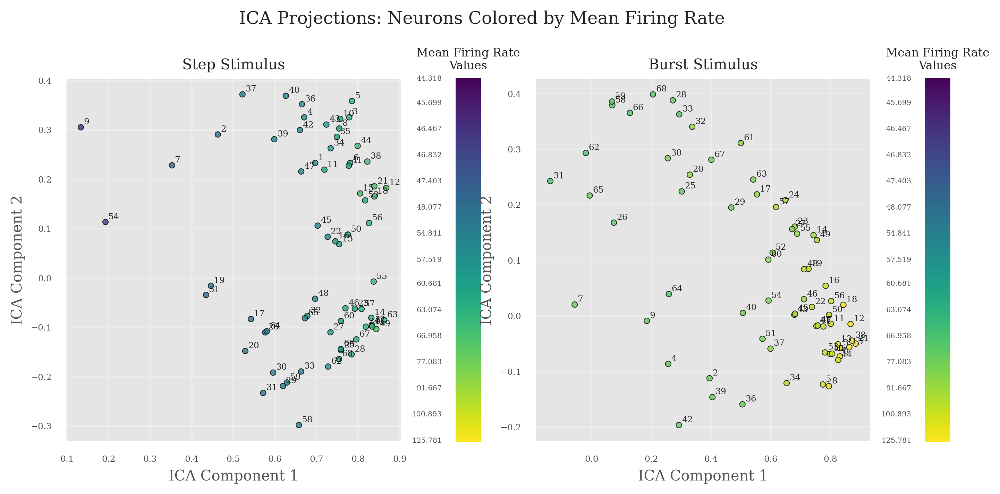

([<Axes: title={'center': 'Step Stimulus'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>,
  <Axes: title={'center': 'Burst Stimulus'}, xlabel='ICA Component 1', ylabel='ICA Component 2'>],
 [<Axes: title={'center': 'Mean Firing Rate\nValues'}>,
  <Axes: title={'center': 'Mean Firing Rate\nValues'}>])

In [67]:
# Example usage with separate color schemes for step and burst
plot_ica_projections_multi_panel_separate(
    mixing_matrices=[mixing_matrix_step, mixing_matrix_burst],
    feature_dfs_list=[foof_features_step, foof_features_burst],
    color_by='Mean_Firing_Rate',
    palettes=[mean_fr_scheme['colors_raw'], mean_fr_scheme['colors_raw']],  # Can use different schemes
    titles=['Step Stimulus', 'Burst Stimulus'],
    heatmap_labels_data_list=[mean_fr_scheme['labels_data'], mean_fr_scheme['labels_data']],
    heatmap_labels_display_list=[mean_fr_scheme['labels_display'], mean_fr_scheme['labels_display']],
    heatmap_colors_list=[mean_fr_scheme['label_colors'], mean_fr_scheme['label_colors']],
    add_annotations=True,
    use_clusters=False
)

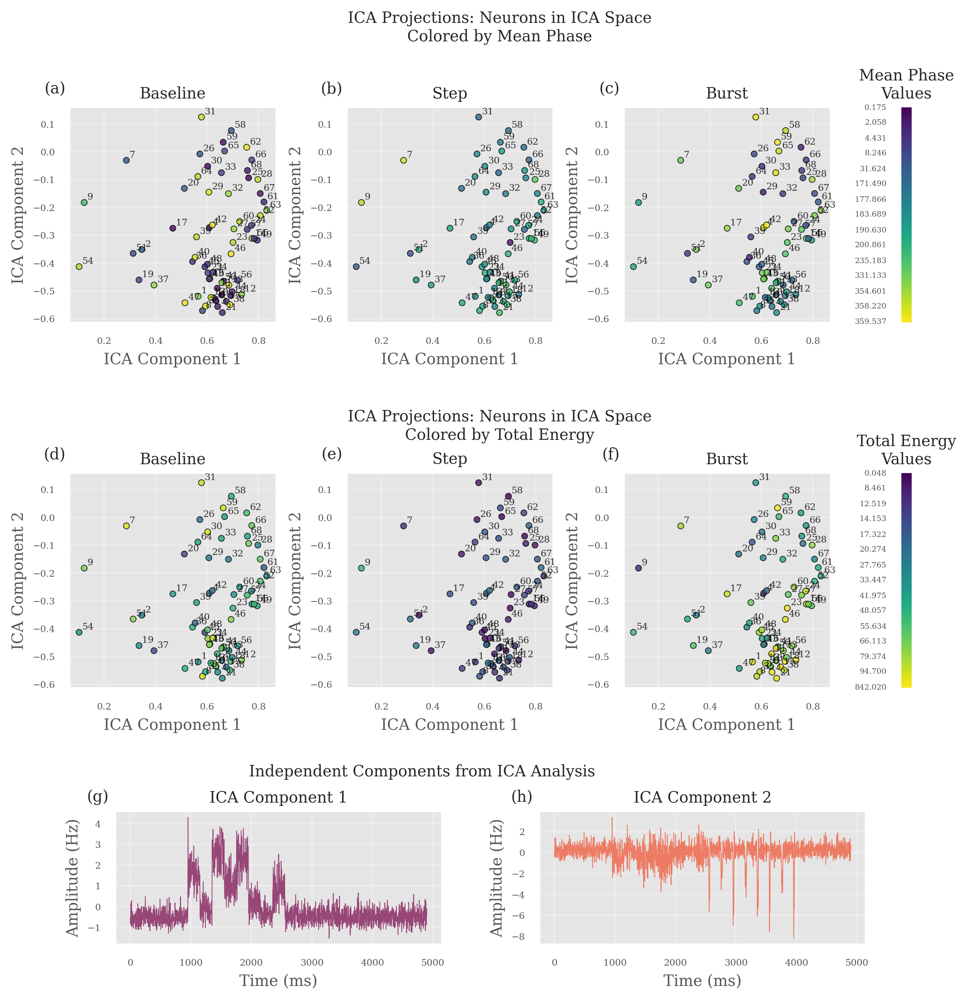

In [68]:
# Create combined figure with all features and components
fig = plt.figure(figsize=(8.27, 12), dpi=300)
gs = GridSpec(3, 4, figure=fig, 
              height_ratios=[1, 1, 0.8],
              width_ratios=[2, 2, 2, 0.1], 
              left=0.03, right=0.95, top=0.88, bottom=0.2,
              hspace=0.75, wspace=0.45)

# ==================================================
# First row: ICA Projections colored by Mean Phase
ax1_phase = fig.add_subplot(gs[0, 0])
ax2_phase = fig.add_subplot(gs[0, 1])
ax3_phase = fig.add_subplot(gs[0, 2])
ax_heatmap_phase = fig.add_subplot(gs[0, 3])

phase_axes = [ax1_phase, ax2_phase, ax3_phase]

plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Mean_Phase',
    palette=phase_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=phase_scheme['labels_data'],
    heatmap_labels_display=phase_scheme['labels_display'],
    heatmap_colors=phase_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False,
    axes=phase_axes,
    heatmap_ax=ax_heatmap_phase,
    fig=fig
)

# Add panel labels for first row
ax1_phase.text(-0.02, 1.05, '(a)', transform=ax1_phase.transAxes, va='bottom', ha='right')
ax2_phase.text(-0.02, 1.05, '(b)', transform=ax2_phase.transAxes, va='bottom', ha='right')
ax3_phase.text(-0.02, 1.05, '(c)', transform=ax3_phase.transAxes, va='bottom', ha='right')

# ==================================================
# Second row: ICA Projections colored by Total Energy
ax1_energy = fig.add_subplot(gs[1, 0])
ax2_energy = fig.add_subplot(gs[1, 1])
ax3_energy = fig.add_subplot(gs[1, 2])
ax_heatmap_energy = fig.add_subplot(gs[1, 3])

energy_axes = [ax1_energy, ax2_energy, ax3_energy]

plot_ica_projections_multi_panel(
    mixing_matrices=[mixing_matrix, mixing_matrix, mixing_matrix],
    feature_dfs_list=[foof_features_baseline, 
                     foof_features_step, 
                     foof_features_burst],
    color_by='Total_Energy',
    palette=energy_scheme['colors_raw'],
    titles=['Baseline', 'Step', 'Burst'],
    heatmap_labels_data=energy_scheme['labels_data'],
    heatmap_labels_display=energy_scheme['labels_display'],
    heatmap_colors=energy_scheme['label_colors'],
    add_annotations=True,
    use_clusters=False,
    axes=energy_axes,
    heatmap_ax=ax_heatmap_energy,
    fig=fig
)

# Add panel labels for second row
ax1_energy.text(-0.02, 1.05, '(d)', transform=ax1_energy.transAxes, va='bottom', ha='right')
ax2_energy.text(-0.02, 1.05, '(e)', transform=ax2_energy.transAxes, va='bottom', ha='right')
ax3_energy.text(-0.02, 1.05, '(f)', transform=ax3_energy.transAxes, va='bottom', ha='right')

# ==================================================
# Third row: ICA Components
gs_bottom = GridSpec(1, 2, figure=fig, 
                     left=0.08, right=0.9, 
                     top=0.35, bottom=0.25,
                     wspace=0.3)

ax_comp1 = fig.add_subplot(gs_bottom[0, 0])  # First component
ax_comp2 = fig.add_subplot(gs_bottom[0, 1])  # Second component

# Create axes list for the ICA components function
comp_axes = [ax_comp1, ax_comp2]

# Call the ICA components function with existing axes
plot_ICA_components(ica_features_pc, n_components=2, fig=fig, axes=comp_axes)

# Add panel labels for bottom row
ax_comp1.text(-0.02, 1.05, '(g)', transform=ax_comp1.transAxes, va='bottom', ha='right')
ax_comp2.text(-0.02, 1.05, '(h)', transform=ax_comp2.transAxes, va='bottom', ha='right')

# Add section titles
fig.text(0.5, 0.94, "ICA Projections: Neurons in ICA Space\nColored by Mean Phase", 
         ha='center', va='center')
fig.text(0.5, 0.64, "ICA Projections: Neurons in ICA Space\nColored by Total Energy", 
         ha='center', va='center')
fig.text(0.415, 0.38, "Independent Components from ICA Analysis", 
         ha='center', va='center')

plt.show()